# Distances computation and examination

This notebook calculates some distances and allows to perform visual examination of their distribution. The first part defines general functions, then there is a section for each of the approaches followed.

In [4]:
import os

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import pickle
import json

import warnings

In [5]:
import sys
from pathlib import Path

# Adding the project root for module imports
project_root = Path().resolve().parents[1]
sys.path.append(str(project_root))

from attendee_profiling import config, constants, utils_models, distances_calculations

Assigning the path to read the tables that serve as input for the models.

In [6]:
MODEL_INPUTS_PATH =  config.MODEL_INPUTS_PATH

Assigning the path to read the tables for describing the clusters.

In [7]:
TABLES_DESCRIPTION_PATH =  config.TABLES_DESCRIPTION_PATH

Assigning the path to write the distance embeddings.

In [10]:
DISTANCES_EMBEDDINGS_PATH =  config.DISTANCES_EMBEDDINGS_PATH

## Global procedures

### Preliminaries

In [11]:
# Read the general features table
trajectory_general_measures_night = pd.read_csv(os.path.join(MODEL_INPUTS_PATH,'trajectory_general_measures_night.csv'))

In [12]:
# Read the time window features table
tw_durations_stage_night = pd.read_csv(os.path.join(MODEL_INPUTS_PATH,'tw_durations_stage_night.csv'))

In [13]:
# Read the sequence of stops table
sequence_stops_night_filtered = pd.read_csv(os.path.join(MODEL_INPUTS_PATH,'sequence_stops_night_filtered.csv'))

In [14]:
# Read the lookup table for trajectories with no events
id_trajectories_no_events_lookup = pd.read_csv(os.path.join(TABLES_DESCRIPTION_PATH,'id_trajectories_no_events_lookup.csv'))

In [15]:
# Read the lookup table for event ids
id_events_lookup = pd.read_csv(os.path.join(TABLES_DESCRIPTION_PATH,'id_events_lookup.csv'))

Definition of functions needed afterwards.

In [16]:
# Generate a logarithmic range for values based on provided minimum and maximum bounds.
def generate_linear_range_list(min_val, max_val, num_values=5):
    return np.linspace(min_val, max_val, num=num_values, dtype=int).tolist()

In [17]:
# Generate a logarithmic range for values based on provided minimum and maximum bounds.
def generate_log_range_list(min_val, max_val, num_values=5):
    return np.logspace(np.log10(min_val), np.log10(max_val), num=5, dtype=int).tolist()

Definition of general parameters for keeping track of the experiments.

In [18]:
distances_embeddings_settings = {}

### Deciding which night to examine

Can be both, which combines both nights into a single dataset (assumes that trajectories between both nights can] be comparable), night 1 or night 2.

In [19]:
night_interest = 'both'

# Store the variable in the general_settings to keep track of the variables used when computing the distances
distances_embeddings_settings['night_interest'] = night_interest

As different nights have different events, and the `trajectory_general_measures_night` has the scores given by each user to each event as columns, I can define a function to include only the events related to each night.

In [20]:
def exclude_event_scores_night(trajectory_general_measures_df, id_events_lookup_df, night):
    id_events_other_night = id_events_lookup_df.loc[id_events_lookup_df['tid']!=night]
    columns_score_exclude = ('adj_score_' + id_events_other_night['event_id']).to_list()

    trajectory_general_measures_df = trajectory_general_measures_df.drop(columns=columns_score_exclude)

    print(f'Columns excluded: \n{columns_score_exclude}')
    return trajectory_general_measures_df

In [21]:
if night_interest=='both':
    # Definition of the path to store the embeddings for the specific case
    path_distances_embeddings = os.path.join(DISTANCES_EMBEDDINGS_PATH,'both')

    print('Both nights are included in the examined datasets.')
elif night_interest in (1,2):
    # Filter the dataframes for the night of interest
    trajectory_general_measures_night = trajectory_general_measures_night.loc[trajectory_general_measures_night['tid']==night_interest]
    tw_durations_stage_night = tw_durations_stage_night.loc[tw_durations_stage_night['tid']==night_interest]
    sequence_stops_night_filtered = sequence_stops_night_filtered.loc[sequence_stops_night_filtered['tid']==night_interest]

    # Exclude the score columns not related to the night of interest
    trajectory_general_measures_night = exclude_event_scores_night(trajectory_general_measures_df=trajectory_general_measures_night,
                                                                   id_events_lookup_df=id_events_lookup,
                                                                   night=night_interest)
    
    # Definition of the path to store the embeddings for the specific case
    path_distances_embeddings = os.path.join(DISTANCES_EMBEDDINGS_PATH,f'night_{night_interest}')
    
    print(f'Night {night_interest} was selected for examination.\n')
else:
    raise Exception("`night_interest` must be 'both', 1 or 2.")

trajectory_general_measures_night
print(f"\nNights in the examined trajectory_general_measures_night: {trajectory_general_measures_night['tid'].unique()}.")
print(f"Nights in the examined tw_durations_stage_night: {tw_durations_stage_night['tid'].unique()}.")
print(f"Nights in the examined sequence_stops_night_filtered: {sequence_stops_night_filtered['tid'].unique()}.")

print(f"Path for saving the distance embeddings: {path_distances_embeddings}.")

Both nights are included in the examined datasets.

Nights in the examined trajectory_general_measures_night: [2 1].
Nights in the examined tw_durations_stage_night: [2 1].
Nights in the examined sequence_stops_night_filtered: [2 1].
Path for saving the distance embeddings: C:\Camilo\Estudio\Padova\Master thesis\Datasets\Processed\distances_embeddings\both.


### Deciding to include trajectories with no events or not

This boolean variable controls whether the trajectories with no events are included or not in the computation of the matrices.

In [22]:
include_trajs_no_events = False

# Store the variable in the general_settings to keep track of the variables used when computing the distances
distances_embeddings_settings['include_trajs_no_events'] = include_trajs_no_events

In [23]:
def exclude_rows(df, exclude_lookup):
    """Excludes rows from a DataFrame based on matching uid and tid combinations in the lookup DataFrame."""
    mask = ~df.set_index(['uid', 'tid']).index.isin(exclude_lookup.set_index(['uid', 'tid']).index)
    return df[mask]

In [24]:
if include_trajs_no_events == True:
   print('Trajectories with no events are included in the examined datasets')
elif include_trajs_no_events == False:
   trajectory_general_measures_night = exclude_rows(trajectory_general_measures_night, id_trajectories_no_events_lookup)
   tw_durations_stage_night = exclude_rows(tw_durations_stage_night, id_trajectories_no_events_lookup)
   sequence_stops_night_filtered = exclude_rows(sequence_stops_night_filtered, id_trajectories_no_events_lookup)

   print('Trajectories with no events are excluded from the examined datasets.')
else:
   raise Exception('`include_trajs_no_events` must be a boolean value')

print(f'Unique trajectories in trajectory_general_measures_night: {trajectory_general_measures_night.shape[0]}')
print(f"Unique trajectories in tw_durations_stage_night: {tw_durations_stage_night[['uid','tid']].drop_duplicates().shape[0]}")
print(f"Unique trajectories in sequence_stops_night_filtered: {sequence_stops_night_filtered[['uid','tid']].drop_duplicates().shape[0]}")

Trajectories with no events are excluded from the examined datasets.
Unique trajectories in trajectory_general_measures_night: 3275
Unique trajectories in tw_durations_stage_night: 3275
Unique trajectories in sequence_stops_night_filtered: 3275


### Storing the number of trajectories

This variable is needed afterwards.

In [25]:
n_trajectories = trajectory_general_measures_night.shape[0]

# Store the variable in the general_settings to keep track of the variables used when computing the distances
distances_embeddings_settings['n_trajectories_dist_notebook'] = n_trajectories

### General framework (combining two distances)

The final distance metric for the clustering algorithms can be a combination of the two distances (the general features distance $D_{GF}$ and the time-series distance $D_{TS}$), so I can "mix" them with a $\lambda$ coefficient, which controls the influence of the time series distance over the final measure:
$$
D = D_{GF} + \lambda D_{TS}
$$

It is worth noting that distances should be nromalized to avoid one dominating the other. Functions for the distance combination and the normalization are in `distances_calculations.py`

I will try different values for lambda, and I will store them in dictionaries as `{lambda_value:combined_distance_matrix}`. For now, I just instantiate the `lambda_values`.

In [26]:
lambda_values = [0, 0.25, 0.5, 0.75, 1]

#### Function to check if a distance is metric (extra)

For a distance to be a *metric*, it must satisfy the following conditions:

1. **Non-negativity**: $d(x, y) \geq 0 \quad \text{and} \quad d(x, y) = 0 \iff x = y.$


2. **Symmetry**: $d(x, y) = d(y, x)$

3. **Triangle inequality**: The direct distance between two points should always be less than or equal to the sum of the distances through an intermediate point.
    $$
   d(x, z) \leq d(x, y) + d(y, z).
    $$

Also, the linear combination of a set of metrics is also a metric.


The euclidean distance is a metric, so if $D_{TS}$ is a metric, the linear combination should also be a metric. I check that empirically for the distance matrices as a sanity check.

In [27]:
def check_triangle_inequality(distance_matrix, verbose=False, epsilon=1e-8):

    n = distance_matrix.shape[0]

    # For a fixed k, extract all the elements of D[i,k] and D[k,j]
    for k in range(n):
        
        # Extract the elements and reshape to broadcast the sum as a matrix instead of a vector
        col_ik = distance_matrix[:, k].reshape(n, 1)  # D[i,k]
        row_kj = distance_matrix[k, :].reshape(1, n)  # D[k,j]

        # Check that D[i,j] <= D[i,k] + D[k,j] for all entries
        if not (distance_matrix <= col_ik + row_kj + epsilon).all():  # The sum has the same shape as D due to broadcasting

            # Checking the violation of the inequality in case it happens
            for i in range(n):
                for j in range(n):
                    if distance_matrix[i, j] > col_ik[i] + row_kj[0, j]  + epsilon:
                        print(f"Violation at i={i}, j={j}, k={k}:")
                        print(f"D[i,j] = {distance_matrix[i, j]}, D[i,k] + D[k,j] = {col_ik[i] + row_kj[0, j]}")
                        
            return False # Returns False if the inequality does not hold
        
        if verbose:
            print(f'Processed intermediate point k = {k}')

    return True  # Returns True if the inequality held for every k

In [28]:
def is_distance_metric(distance_matrix):
    # Symmetry check
    if not np.allclose(distance_matrix, distance_matrix.T, atol=1e-8):
        print("Distance matrix is not symmetric.")
        return False

    # Non-negativity check
    if np.any(distance_matrix < 0):
        print("Distance matrix has negative entries.")
        return False

    # Zero-diagonal check
    if not np.allclose(np.diag(distance_matrix), 0, atol=1e-8):
        print("Distance matrix does not have zeros on the diagonal.")
        return False

    # Triangle inequality check
    if check_triangle_inequality(distance_matrix, verbose=True) == False:
        print(f"Triangle inequality does not hold.")
        return False
    
    print('\n------------------------------------------')
    print("The distance matrix is metric.")
    return True

### UMAP distance embeddings

As I am working with a custom distance function that combines global feature distances and time-series distances (each of which can be high-dimensional) it is useful to embed the resulting distances into a space that can be visualized and potentially be used for analyzing the hidden structures in the data. UMAP is a powerful and flexible non-linear tool for this, which allows to work with precomputed distances and tries to learn the data manifold based on the local structure of points with respect to their neighbors.

The functions for this are in `distances_calculations.py`

## General features distance $\left(D_{GF}\right)$

First I check the table structure.

In [29]:
trajectory_general_measures_night.sort_values(by='confidence_metric_adj',ascending=False)

,uid,tid,observations_user_night_original,confidence_metric_adj,timespan_festival_mins,arrival_festival_mins,departure_festival_mins,average_cell_density,num_attended_events,distance_straight_line,...,adj_score_ev_41,adj_score_ev_42,adj_score_ev_43,adj_score_ev_44,adj_score_ev_45,adj_score_ev_46,adj_score_ev_47,adj_score_ev_48,adj_score_ev_49,adj_score_ev_50
390,1c70b4cd20caf6dd1eb09216679b1698b1f685b65c3f43...,1,4990,0.731059,451.533333,220.216667,671.750000,7.720686,6,18.823388,...,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000
3640,fc4ea7c3935dc1f7c102d51666383094825b123acc3c71...,2,3573,0.697424,264.466667,217.716667,482.183333,4.274888,3,7.826886,...,0.006763,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000
1110,4eda0124595b4e717d742743c54e9603b871bbc0b7d52a...,2,3788,0.682821,509.133333,171.900000,681.033333,6.770070,7,15.288184,...,0.008657,0.0,0.000000,0.0,0.0,0.009583,0.0,0.0,0.0,0.016254
3395,e9fc717d0987658ef8d98e00b93450e9c1cd305fb6d487...,1,3556,0.677692,546.983333,138.616667,685.600000,4.379879,8,17.759551,...,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000
954,4369be4e97e7c144c5b3521a6a43569650b69ab4dc0572...,2,3653,0.666770,604.233333,102.233333,706.466667,8.706013,10,16.052719,...,0.000000,0.0,0.002033,0.0,0.0,0.002502,0.0,0.0,0.0,0.005695
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2473,a78dcc24cf26acbf898047b763869b66b98d2c5ae441a6...,1,37,0.500019,502.083333,66.133333,568.216667,2.303030,1,0.732542,...,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000
168,0c7c145537ad8db5182e7afca14e4628e25974601ed141...,1,36,0.500018,483.950000,89.500000,573.450000,2.064516,1,0.337256,...,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000
1961,875538c8859931101fad33df1a0d3ffc26e459372f9ce4...,1,39,0.500016,599.333333,29.000000,628.333333,1.030303,1,0.244892,...,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000
2020,8a7e9757650c16bbae0c6b38f2371b68fc778e0d658fae...,1,19,0.500014,301.800000,22.316667,324.116667,1.588235,1,0.320865,...,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000


In [30]:
trajectory_general_measures_night.columns

Index(['uid', 'tid', 'observations_user_night_original',
       'confidence_metric_adj', 'timespan_festival_mins',
       'arrival_festival_mins', 'departure_festival_mins',
       'average_cell_density', 'num_attended_events', 'distance_straight_line',
       'radius_of_gyration', 'total_stops_duration_mins',
       'duration_electronic_accessible_share',
       'duration_electronic_hypnotic_share', 'duration_other_genres_share',
       'duration_no_event_share', 'duration_bar_restaurant_share',
       'duration_other_share', 'duration_stage_share',
       'duration_SonarClub_share', 'duration_SonarPub_share',
       'duration_SonarLab x Printworks_share', 'duration_SonarCar_share',
       'duration_Restaurants_share', 'duration_Bumper cars_share',
       'duration_Bar: Restaurants-Bumper cars_share',
       'duration_Entrance/Cashless_share',
       'avg_adj_score_electronic_accessible',
       'avg_adj_score_electronic_hypnotic', 'avg_adj_score_other_genres',
       'adj_score_ev_1'

I make a selection of these features to be taken into account for computing the distances.

In [31]:
# Filter column names that contain 'adj_score_ev_'
event_score_columns = [col for col in trajectory_general_measures_night.columns if 'adj_score_ev_' in col]

In [32]:
# Selecting the columns that will be taken into account for computing the general distances
# Some of these values are only meant to be descriptive, but not a feature
trajectory_general_features_df_night = trajectory_general_measures_night[(['uid', 'tid', # Trajectory identifiers
                                                                          
                                                                          # General features
                                                                          'timespan_festival_mins',
                                                                          'arrival_festival_mins', 'departure_festival_mins',
                                                                          'average_cell_density', 'num_attended_events',

                                                                          # Movement general features 
                                                                          'distance_straight_line', 'radius_of_gyration',

                                                                          # Duration at events features 
                                                                          'total_stops_duration_mins',
                                                                          #'avg_adj_score_electronic_accessible',
                                                                          #'avg_adj_score_electronic_hypnotic', 
                                                                          #'avg_adj_score_other_genres'
                                                                          'duration_bar_restaurant_share',
                                                                          'duration_other_share', 'duration_stage_share',

                                                                          'duration_no_event_share'
                                                                          ])
                                                                          + event_score_columns].copy()


removed_columns = set(trajectory_general_measures_night.columns) - set(trajectory_general_features_df_night.columns)
print(f'Columns removed from the general features for distance computation: \n{removed_columns}')
print(f'\nGeneral features used for the distance computation: {trajectory_general_features_df_night.columns}')

Columns removed from the general features for distance computation: 
{'duration_SonarLab x Printworks_share', 'duration_Bumper cars_share', 'duration_electronic_accessible_share', 'avg_adj_score_electronic_accessible', 'duration_SonarCar_share', 'observations_user_night_original', 'duration_Entrance/Cashless_share', 'avg_adj_score_electronic_hypnotic', 'duration_electronic_hypnotic_share', 'duration_Bar: Restaurants-Bumper cars_share', 'duration_SonarClub_share', 'duration_other_genres_share', 'duration_SonarPub_share', 'avg_adj_score_other_genres', 'confidence_metric_adj', 'duration_Restaurants_share'}

General features used for the distance computation: Index(['uid', 'tid', 'timespan_festival_mins', 'arrival_festival_mins',
       'departure_festival_mins', 'average_cell_density',
       'num_attended_events', 'distance_straight_line', 'radius_of_gyration',
       'total_stops_duration_mins', 'duration_bar_restaurant_share',
       'duration_other_share', 'duration_stage_share',
    

Computing the euclidean distance for the general features.

In [33]:
general_euclidean_distances = distances_calculations.compute_general_euclidean_distance(trajectory_general_features_df=trajectory_general_features_df_night)
general_euclidean_distances

array([[0.        , 5.57032645, 5.41396325, ..., 6.19521093, 5.33840745,
        5.91314155],
       [5.57032645, 0.        , 5.15353541, ..., 5.77369728, 4.35125638,
        4.60469454],
       [5.41396325, 5.15353541, 0.        , ..., 5.78376137, 5.06313677,
        5.62665392],
       ...,
       [6.19521093, 5.77369728, 5.78376137, ..., 0.        , 5.72457171,
        6.17871216],
       [5.33840745, 4.35125638, 5.06313677, ..., 5.72457171, 0.        ,
        4.3806693 ],
       [5.91314155, 4.60469454, 5.62665392, ..., 6.17871216, 4.3806693 ,
        0.        ]])

### Distance examination

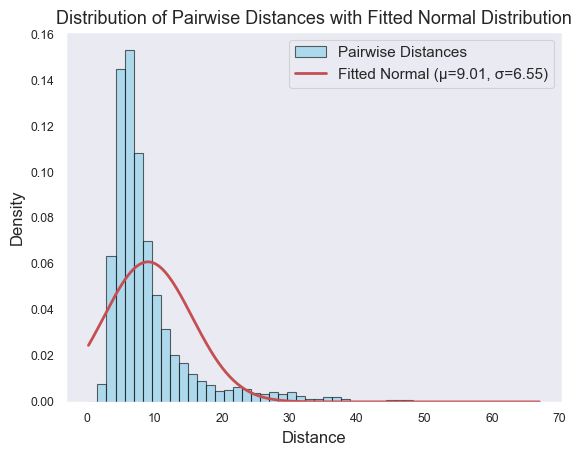

In [34]:
distances_calculations.check_distance_distribution(distance_matrix=general_euclidean_distances)

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code\distances_calculations.py:483: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


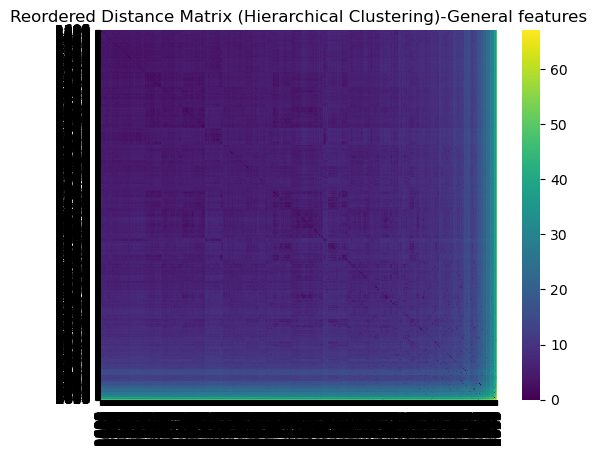

In [31]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=general_euclidean_distances, label_matrix='General features')

#### Distances normalizations

In [35]:
# Normalize the pairwise distance matrices
general_euclidean_distances_normalized = distances_calculations.normalize_min_max(general_euclidean_distances)

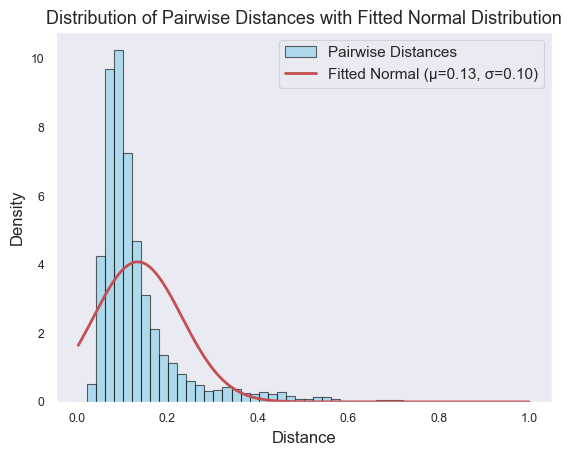

In [36]:
distances_calculations.check_distance_distribution(distance_matrix=general_euclidean_distances_normalized)

In [37]:
#distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=general_euclidean_distances_normalized, label_matrix='GF dist normalized')

##### Checking if a distance is metric

In [38]:
#is_distance_metric(general_euclidean_distances_normalized.to_numpy())

***Now I perform experiments with different time series distances $\left(D_{TS}\right)$.***

## General features with PCA distance 

There may be many redundant coordinates when including all the event scores, so the distances might be improved if PCA was applied on it.

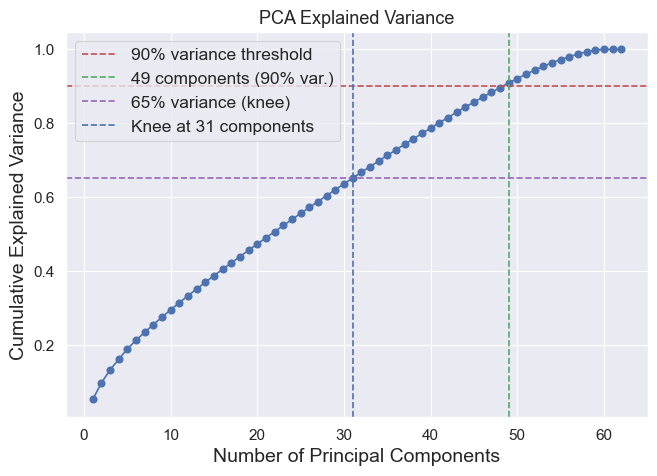

Number of components for 90% variance: 49
Knee detected at: 31 components


In [37]:
n_comp_threshold_pca_general, knee_components_pca_general, cumulative_variance_pca_general = distances_calculations.check_general_pca_variance(trajectory_general_features_df_night,
                                                                                                                                               variance_threshold=0.9)

In [38]:
general_pca_euclidean_distances = distances_calculations.compute_general_euclidean_distance_pca(trajectory_general_features_df_night,
                                                                                                n_components=knee_components_pca_general)
general_pca_euclidean_distances

array([[0.        , 5.57032645, 5.41396325, ..., 6.19521093, 5.33840745,
        5.91314155],
       [5.57032645, 0.        , 5.15353541, ..., 5.77369728, 4.35125638,
        4.60469454],
       [5.41396325, 5.15353541, 0.        , ..., 5.78376137, 5.06313677,
        5.62665392],
       ...,
       [6.19521093, 5.77369728, 5.78376137, ..., 0.        , 5.72457171,
        6.17871216],
       [5.33840745, 4.35125638, 5.06313677, ..., 5.72457171, 0.        ,
        4.3806693 ],
       [5.91314155, 4.60469454, 5.62665392, ..., 6.17871216, 4.3806693 ,
        0.        ]])

### Distance examination

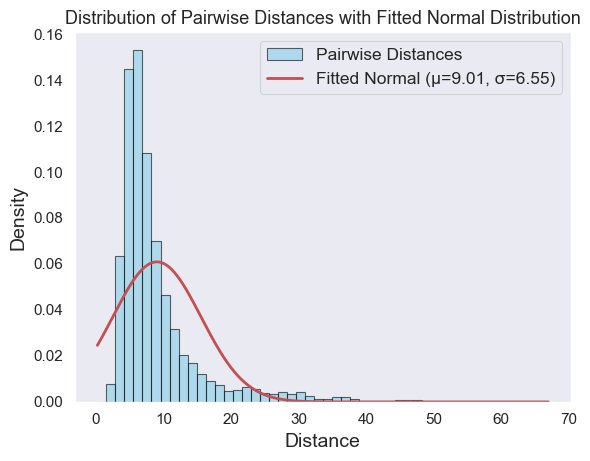

In [39]:
distances_calculations.check_distance_distribution(distance_matrix=general_pca_euclidean_distances)

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-reorg\attendee_profiling\distances_calculations.py:500: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


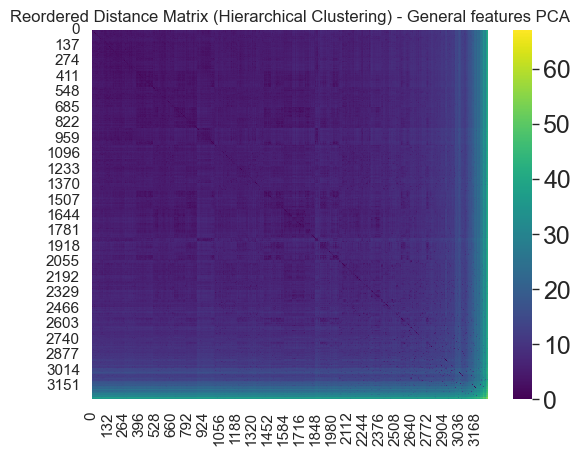

In [40]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=general_pca_euclidean_distances, 
                                                            label_matrix='General features PCA')

### PCA  distances normalizations

However, to mantain control over the influence of each of the distance I need to normalize them to make them comparable in scale.

In [41]:
# Normalize the pairwise distance matrices
general_pca_euclidean_distances_normalized = distances_calculations.normalize_min_max(general_pca_euclidean_distances)

- Time series distance normalization

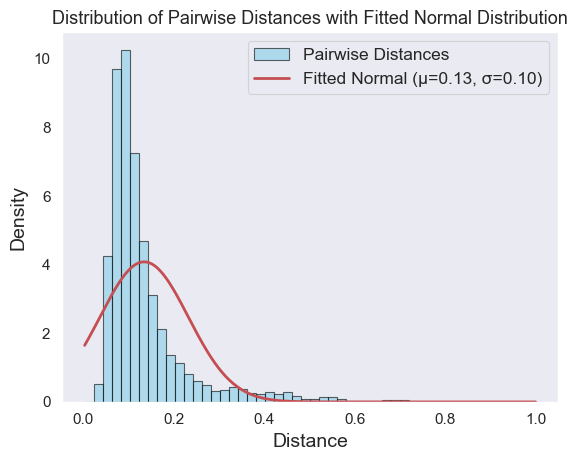

In [42]:
distances_calculations.check_distance_distribution(distance_matrix=general_pca_euclidean_distances_normalized)

##### Checking if a distance is metric

In [46]:
#is_distance_metric(general_pca_euclidean_distances_normalized)

## Time window euclidean distances for the trajectories 

In [43]:
tw_features = tw_durations_stage_night

The formula I am computing is essentially 
$$
{D_{TS}(A,B)= \frac{1}{T} \sqrt{\delta(a_1,b_1)^2+\ldots+\delta(a_T,b_T)^2}},
$$ 

where $\delta$ is the euclidean distance and $a_t,b_t \in \mathbb{R}^d$, so essentially, it is equivalent to computing the Frobenius norm of the pairwise difference between `tra_i` and `traj_j`, if they are represented as a matrix with $T$ rows (time windows) and $d$ columns (features).

This can be efficiently done by representing the trajectories as 3D arrays with shape ($n$, $T$, $d$), and then flattening the trajectory arrays (leaving a 1D vector with length = $T*d$ for each trajectory) and passing the vectors to the pairwise_distances function.

In [44]:
tw_euclidean_distances = distances_calculations.compute_ts_euclidean_distance(tw_features_df=tw_features)
tw_euclidean_distances

array([[0.        , 1.69025331, 1.62029313, ..., 1.32461978, 1.73566972,
        1.91341674],
       [1.69025331, 0.        , 1.92235073, ..., 1.72548793, 1.82707759,
        1.78862022],
       [1.62029313, 1.92235073, 0.        , ..., 1.66556434, 1.8741929 ,
        1.42150849],
       ...,
       [1.32461978, 1.72548793, 1.66556434, ..., 0.        , 1.6585952 ,
        1.94461204],
       [1.73566972, 1.82707759, 1.8741929 , ..., 1.6585952 , 0.        ,
        2.16329166],
       [1.91341674, 1.78862022, 1.42150849, ..., 1.94461204, 2.16329166,
        0.        ]])

### Distance examination

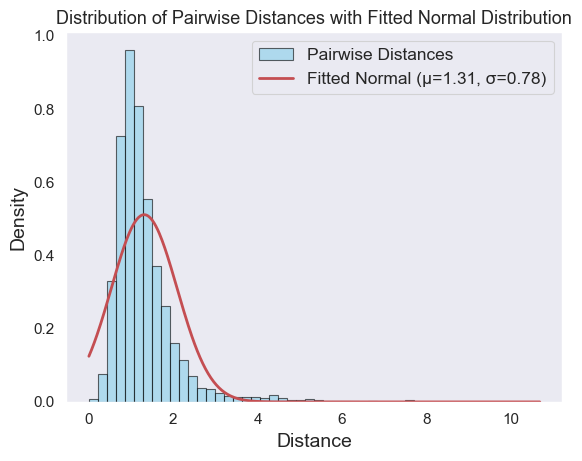

In [45]:
distances_calculations.check_distance_distribution(distance_matrix=tw_euclidean_distances)

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code\distances_calculations.py:483: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


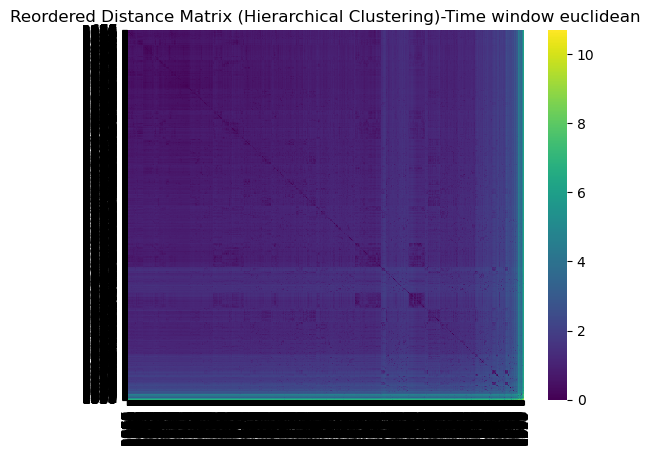

In [50]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=tw_euclidean_distances, label_matrix='Time window euclidean')

### TW distances normalizations

However, to mantain control over the influence of each of the distance I need to normalize them to make them comparable in scale.

In [46]:
tw_euclidean_distances_normalized = distances_calculations.normalize_min_max(tw_euclidean_distances)

- Time series distance normalization

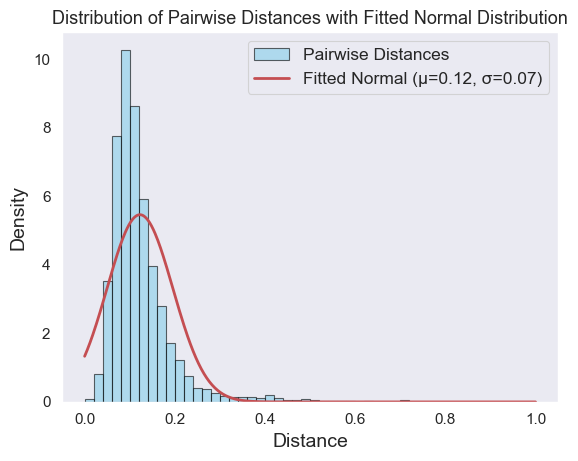

In [47]:
distances_calculations.check_distance_distribution(distance_matrix=tw_euclidean_distances_normalized)

##### Checking if a distance is metric

In [48]:
#is_distance_metric(tw_euclidean_distances_normalized)

## Time window PCA euclidean distances for the trajectories 

There may be many redundant coordinates for the time window distance, so the distances might be improved if PCA was applied on int.

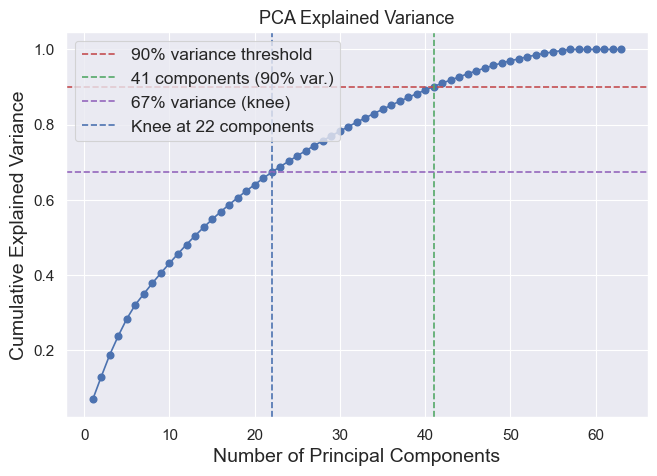

Number of components for 90% variance: 41
Knee detected at: 22 components


In [49]:
n_comp_threshold_pca_tw, knee_components_pca_tw, cumulative_variance_pca_tw = distances_calculations.check_tw_pca_variance(tw_features_df=tw_features, 
                                                                                                                           variance_threshold=0.9)

In [50]:
tw_pca_euclidean_distances = distances_calculations.compute_ts_euclidean_distance_pca(tw_features_df=tw_features, 
                                                                                      n_components=knee_components_pca_tw)
tw_pca_euclidean_distances

array([[0.        , 1.03275572, 1.24413775, ..., 0.55683382, 1.05238392,
        1.6507867 ],
       [1.03275572, 0.        , 1.36491621, ..., 1.03398699, 0.93179544,
        1.50269326],
       [1.24413775, 1.36491621, 0.        , ..., 1.2779647 , 1.33408592,
        0.98339027],
       ...,
       [0.55683382, 1.03398699, 1.2779647 , ..., 0.        , 0.89041364,
        1.67399689],
       [1.05238392, 0.93179544, 1.33408592, ..., 0.89041364, 0.        ,
        1.75039818],
       [1.6507867 , 1.50269326, 0.98339027, ..., 1.67399689, 1.75039818,
        0.        ]])

### Distance examination

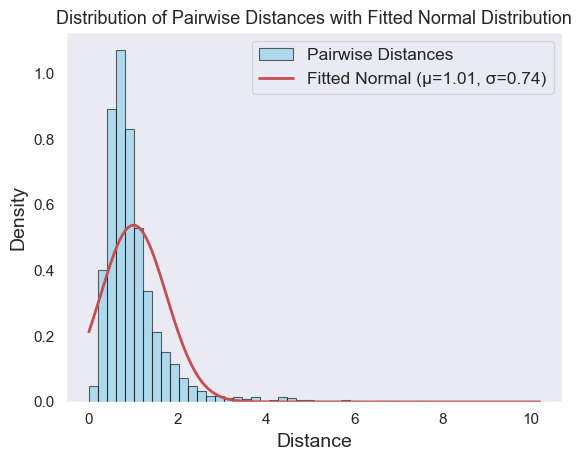

In [51]:
distances_calculations.check_distance_distribution(distance_matrix=tw_pca_euclidean_distances)

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-reorg\attendee_profiling\distances_calculations.py:500: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


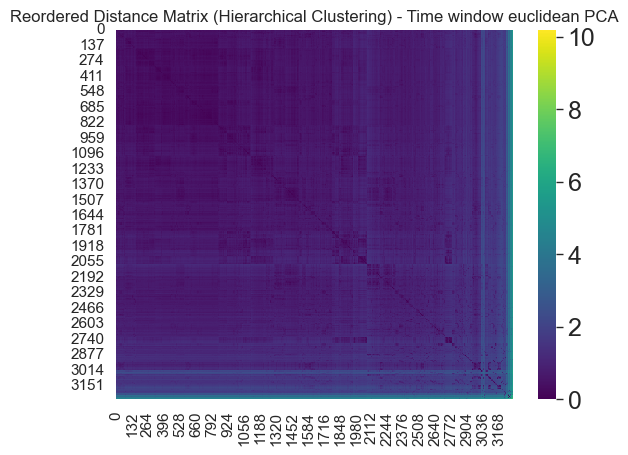

In [52]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=tw_pca_euclidean_distances, 
                                                            label_matrix='Time window euclidean PCA')

### TW distances normalizations

However, to mantain control over the influence of each of the distance I need to normalize them to make them comparable in scale.

In [54]:
tw_pca_euclidean_distances_normalized = distances_calculations.normalize_min_max(tw_pca_euclidean_distances)

- Time series distance normalization

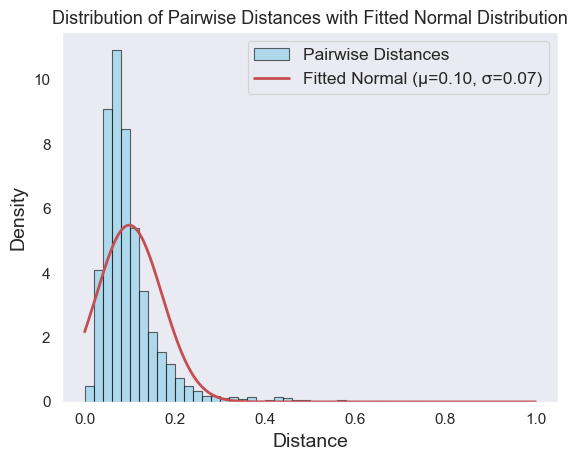

In [56]:
distances_calculations.check_distance_distribution(distance_matrix=tw_pca_euclidean_distances_normalized)

##### Checking if a distance is metric

In [57]:
#is_distance_metric(tw_euclidean_distances_normalized)

## DTW distance

In [67]:
sequence_stops_night_filtered.dtypes

uid                      object
tid                       int64
start_time_stop          object
end_time_stop            object
start_time_stop_mins    float64
end_time_stop_mins      float64
duration_stop_mins      float64
x_centroid_proj         float64
y_centroid_proj         float64
lng_centroid            float64
lat_centroid            float64
stage                    object
event_title              object
genre_grouped            object
views_youtube           float64
dtype: object

The definition of a simple function to compute the DTW or the LCSS distance matrices is in `distances_calculations.py` (this approach is faster than the `cdist_dtw` function in `tslearn`).

I first need to convert the dataframe to a suitable numpy array.

In [68]:
sequence_stops_night_array_dtw = utils_models.sequence_df_to_numpy(sequences_df=sequence_stops_night_filtered,
                                                                   feature_columns=['x_centroid_proj','y_centroid_proj'],
                                                                   sequence_identifiers=['uid', 'tid'])
sequence_stops_night_array_dtw.shape

(3275, 20, 2)

In [69]:
settings_dtw = {'distance_type':'DTW'}

dtw_distances=distances_calculations.dtw_lcss_computation(settings=settings_dtw,
                                                          trajectories_array=sequence_stops_night_array_dtw,
                                                          verbose=True)

np.save(os.path.join(path_distances_embeddings,'dtw_distances.npy'), dtw_distances)

Distances computed for trajectory 0
Distances computed for trajectory 1
Distances computed for trajectory 2
Distances computed for trajectory 3
Distances computed for trajectory 4
Distances computed for trajectory 5
Distances computed for trajectory 6
Distances computed for trajectory 7
Distances computed for trajectory 8
Distances computed for trajectory 9
Distances computed for trajectory 10
Distances computed for trajectory 11
Distances computed for trajectory 12
Distances computed for trajectory 13
Distances computed for trajectory 14
Distances computed for trajectory 15
Distances computed for trajectory 16
Distances computed for trajectory 17
Distances computed for trajectory 18
Distances computed for trajectory 19
Distances computed for trajectory 20
Distances computed for trajectory 21
Distances computed for trajectory 22
Distances computed for trajectory 23
Distances computed for trajectory 24
Distances computed for trajectory 25
Distances computed for trajectory 26
Distances c

In [70]:
# Load the NumPy array from the file
dtw_distances = np.load(os.path.join(path_distances_embeddings,'dtw_distances.npy'))

### Distance examination

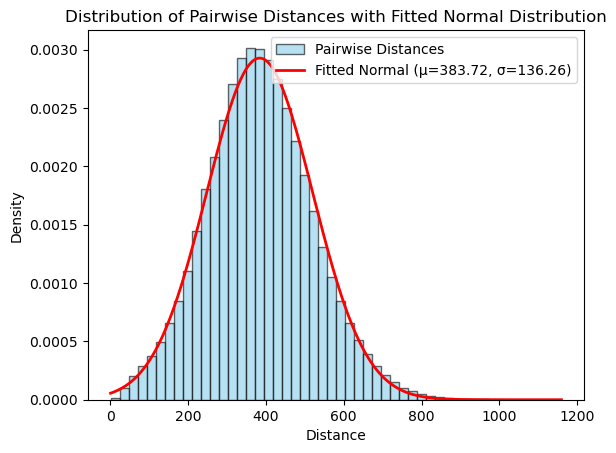

In [71]:
distances_calculations.check_distance_distribution(distance_matrix=dtw_distances)

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code\distances_calculations.py:483: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


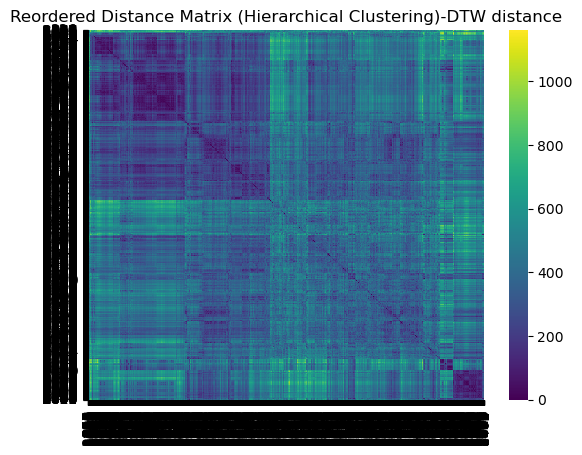

In [72]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=dtw_distances, 
                                                            label_matrix='DTW distance')

#### DTW distances normalizations

In [ ]:
dtw_distances_normalized = distances_calculations.normalize_min_max(dtw_distances)

- Time series distance normalization

In [75]:
#distances_calculations.check_distance_distribution(distance_matrix=dtw_distances_normalized)

In [76]:
#distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=dtw_distances_normalized, label_matrix='DTW distance normalized')

##### Checking if distance is metric

In [77]:
#is_distance_metric(normalized_dtw_min_max)

## LCSS distance

In this case, choosing a spatial threshold for considering a "match" between locations might not be appropiate. The spatial meaningfulness is better captured by the presence within the same stages, as they are surrounded by the context of the events that where ocurring at these places.

Unlike the analyses by night, to avoid obtaining the clusters corresponding to the attendees of each of the two nights, I analyze this as a sequence of visited stages instead of visited events, so that the instances have common grounds.

In [78]:
# Create a mapping from stage to integer IDs
stage_id_mapping = {stage: id_stage for id_stage, stage in enumerate(sequence_stops_night_filtered['stage'].unique())}
print(f'Stage id mapping: \n{stage_id_mapping}')

# Apply mapping to the dataframe
sequence_stops_night_filtered['id_stage'] = sequence_stops_night_filtered['stage'].map(stage_id_mapping)

sequence_stops_night_filtered[['stage','id_stage']]

Stage id mapping: 
{'NA-Entrada': 0, 'SonarClub': 1, 'SonarCar': 2, 'SonarPub': 3, 'NA-Restauración': 4, 'SonarLab x Printworks': 5, 'NA-autos_choques': 6, 'NA-autos_choques_barra': 7, 'NA-Cashless1': 8}


,stage,id_stage
0,NA-Entrada,0
1,SonarClub,1
2,SonarClub,1
3,SonarCar,2
4,SonarPub,3
...,...,...
20982,SonarLab x Printworks,5
20983,SonarLab x Printworks,5
20984,SonarLab x Printworks,5
20985,SonarLab x Printworks,5


In [79]:
sequence_stops_night_array_lcss = utils_models.sequence_df_to_numpy(sequences_df=sequence_stops_night_filtered,
                                                                    feature_columns=['id_stage'],
                                                                    sequence_identifiers=['uid', 'tid'])
sequence_stops_night_array_lcss.shape

(3275, 20, 1)

In [80]:
settings_lcss = {'distance_type':'LCSS',
                 'epsilon_LCSS':0} # I am applying a "categorical" LCSS, so I am requiring strict matches

lcss_distances = distances_calculations.dtw_lcss_computation(settings_lcss,
                                                             trajectories_array=sequence_stops_night_array_lcss,
                                                             verbose=True)

np.save(os.path.join(path_distances_embeddings,'lcss_distances.npy'), lcss_distances)

Distances computed for trajectory 0
Distances computed for trajectory 1
Distances computed for trajectory 2
Distances computed for trajectory 3
Distances computed for trajectory 4
Distances computed for trajectory 5
Distances computed for trajectory 6
Distances computed for trajectory 7
Distances computed for trajectory 8
Distances computed for trajectory 9
Distances computed for trajectory 10
Distances computed for trajectory 11
Distances computed for trajectory 12
Distances computed for trajectory 13
Distances computed for trajectory 14
Distances computed for trajectory 15
Distances computed for trajectory 16
Distances computed for trajectory 17
Distances computed for trajectory 18
Distances computed for trajectory 19
Distances computed for trajectory 20
Distances computed for trajectory 21
Distances computed for trajectory 22
Distances computed for trajectory 23
Distances computed for trajectory 24
Distances computed for trajectory 25
Distances computed for trajectory 26
Distances c

In [81]:
# Load the NumPy array from the file
lcss_distances = np.load(os.path.join(path_distances_embeddings,'lcss_distances.npy'))

### Distance examination

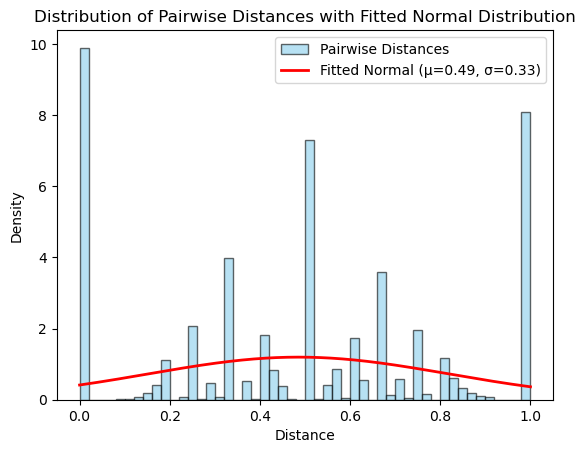

In [82]:
distances_calculations.check_distance_distribution(distance_matrix=lcss_distances)

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code\distances_calculations.py:483: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


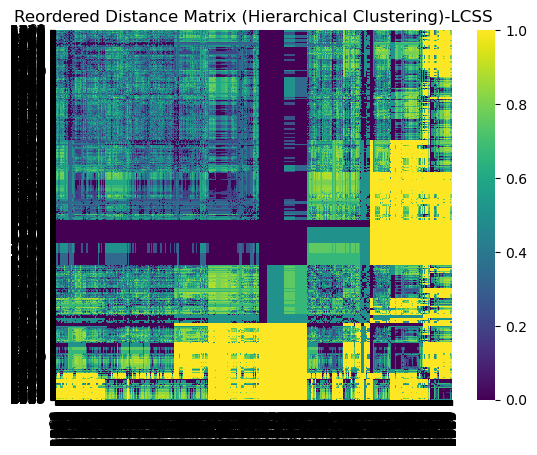

In [83]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=lcss_distances, label_matrix='LCSS')

#### LCSS distances normalizations

In [ ]:
lcss_distances_normalized = distances_calculations.normalize_min_max(lcss_distances)

- Time series distance normalization

In [86]:
#distances_calculations.check_distance_distribution(distance_matrix=lcss_distances_normalized)

In [87]:
#plot_hierarchical_clustering_heatmap(distance_matrix=lcss_distances_normalized, label_matrix='LCSS distance normalized')

##### Checking if distance is metric

In [88]:
#is_distance_metric(normalized_lcss_min_max)

## Combined distances (TW euclidean and GF)

### Combining the distances

I will check the effectiveness of the combined distances for different values of lambda, so I define an array of lambda values.

In [89]:
tw_euclidean_combined_distances_dict = {lambda_val: 
                                            distances_calculations.compute_combined_distance(distances_1=general_euclidean_distances_normalized,
                                                                                            distances_2=tw_euclidean_distances_normalized,
                                                                                            lambda_value=lambda_val
                                                                                            )
                                              for lambda_val in lambda_values
                                            }


In [90]:
tw_euclidean_combined_distances_dict[0.25]

array([[0.        , 0.12266826, 0.11869816, ..., 0.12343907, 0.12026994,
        0.13300497],
       [0.12266826, 0.        , 0.12187863, ..., 0.12652742, 0.10767753,
        0.11055978],
       [0.11869816, 0.12187863, 0.        , ..., 0.12527567, 0.11940297,
        0.11722143],
       ...,
       [0.12343907, 0.12652742, 0.12527567, ..., 0.        , 0.12422935,
        0.13769781],
       [0.12026994, 0.10767753, 0.11940297, ..., 0.12422935, 0.        ,
        0.1159823 ],
       [0.13300497, 0.11055978, 0.11722143, ..., 0.13769781, 0.1159823 ,
        0.        ]])

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code\distances_calculations.py:483: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


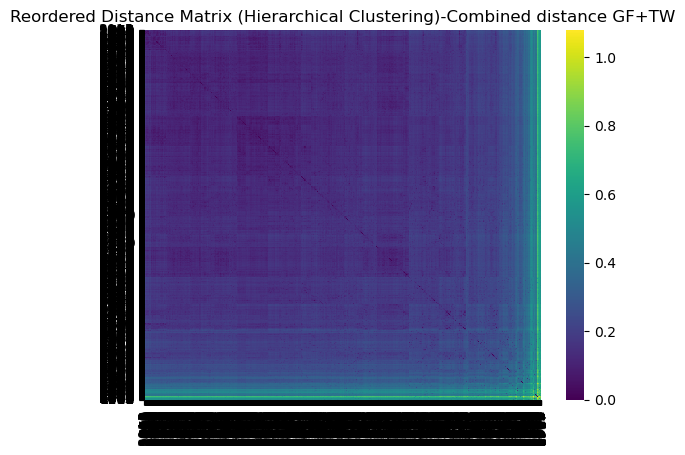

In [91]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=tw_euclidean_combined_distances_dict[0.5], 
                                                            label_matrix='Combined distance GF+TW')

### Distance examination

##### Checking if distance is metric

In [92]:
#is_distance_metric(tw_euclidean_combined_distances_dict[0.25])

##### 2D UMAP embeddings (TW)

Although clustering the embedded space is somewhat controversial as it may not preserve the original distances and densities, as this problem involves custom and complex distances derived from multidimensional spaces, it is hard to have a common benchmark to validate the results from different clustering approaches in the original space.

The DBCV validation metric is assumes euclidean distances in a given space for some properties to hold, so measring it in the original space might be misleading and hard to implement as non-metric distances are not originally considered.

Addtionally, as clustering benefits from mitigating the curse of dimensionality, it makes sense to try UMAP also for clustering. Although not perfect, UMAP is still a powerful mechanism that attempts to approximate the hidden structure of the data. As a sort of heuristic in absence of better objective metrics, the clusters will be performed and quantitatively evaluated in the embedded space. In any case, the clusters will be validated in terms of interpretation of the measures in the original space, which is the ultimate goal in this analysis.

Following the [guidelines for clustring with umap](https://umap-learn.readthedocs.io/en/latest/clustering.html), for this application, it is useful to pack points together densely, and using a low value for `min_dist` serves this purpose, so I set it at 0.

On the other hand, the authors recommend to use "larger" values for `n_neighbors`, as such a setting captures a more global structure. In this case, to avoid exploding the hyperparameter space, having a common ground, and avoid overusing the embedding configuration to boost clustering performance, I just try some values spread on a logarithmic scale from 10 to a quarter of the number of instances, visually assess the embeddings in 2D, and fix one `n_neighbors` value for all experiments.

In [93]:
n_neighbors_list = generate_log_range_list(10, round(0.25*n_trajectories), num_values=5)

n_neighbors_list

[10, 30, 90, 272, 819]

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_2d_10neighbors.pkl

Plot for n_neighbors = 10


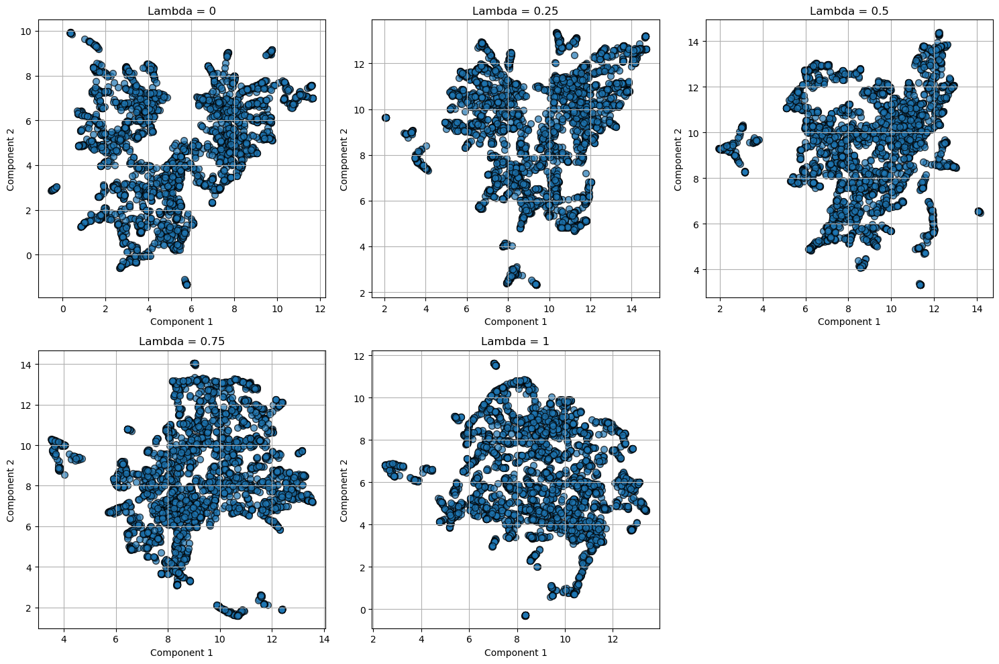

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_2d_30neighbors.pkl

Plot for n_neighbors = 30


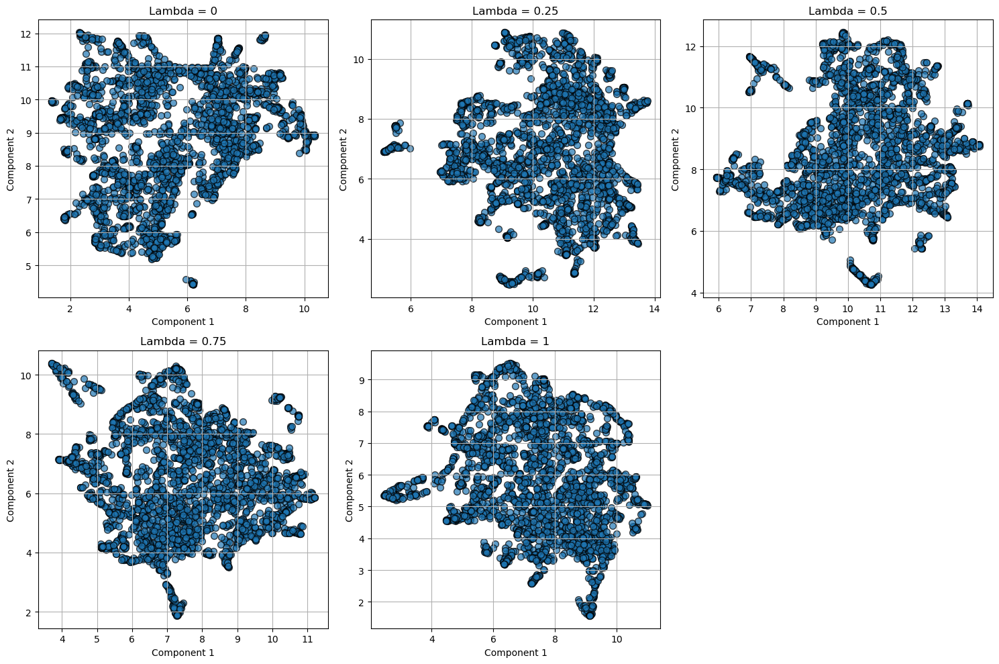

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_2d_90neighbors.pkl

Plot for n_neighbors = 90


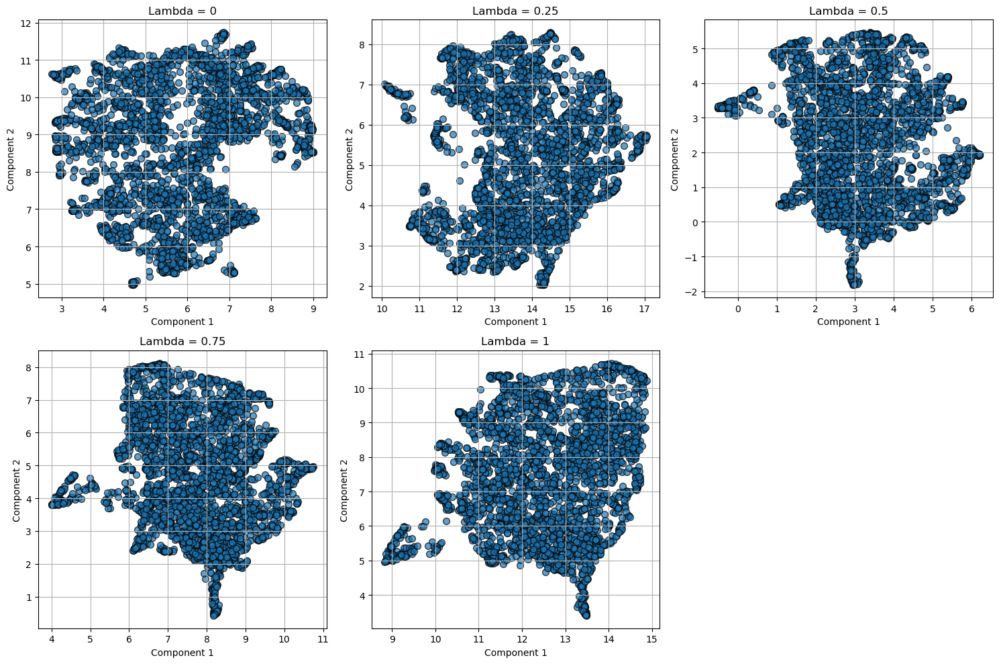

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_2d_272neighbors.pkl

Plot for n_neighbors = 272


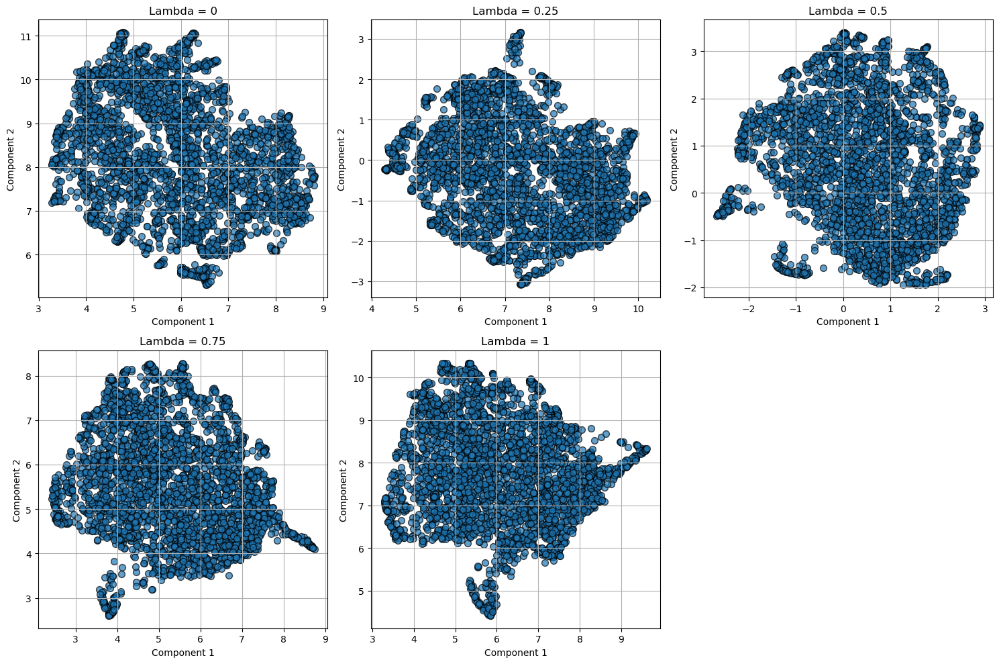

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_2d_819neighbors.pkl

Plot for n_neighbors = 819


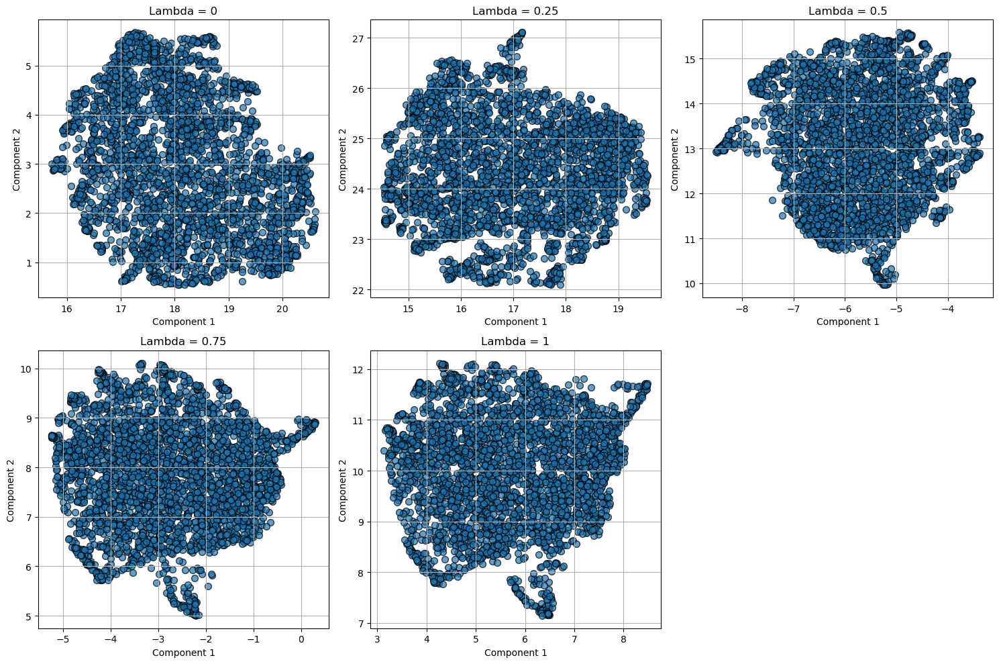

In [94]:
# Suppress warnings only within this cell
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    
    distances_calculations.check_multi_n_neighbors_umap(n_neighbors_list=n_neighbors_list,
                                                        combined_distances_dict=tw_euclidean_combined_distances_dict,
                                                        path_rw=path_distances_embeddings,
                                                        distance_type='tw',
                                                        read_write='write',
                                                        )

Visually, it appears that with more than 26 neighbors, the local structures tend to merge into a single mass, which would be undesirable for clustering. For this reason, I fix the `n_neighbors` at 26. Also, I store the embeddings corresponding to this value on a variable for the final visual assessment in 2D.

In [95]:
n_neighbors_umap = n_neighbors_list[1]

# Store the variable in the general_settings to keep track of the variables used when computing the distances
distances_embeddings_settings['n_neighbors_umap'] = n_neighbors_umap

In [96]:
umaps_tw_2d_final_filename = os.path.join(path_distances_embeddings,f'umaps_tw_2d_{n_neighbors_umap}neighbors.pkl')
with open(umaps_tw_2d_final_filename, 'rb') as f:
    umaps_tw_2d_final = pickle.load(f)
    print(f'Loaded UMAP distance embeddings from {umaps_tw_2d_final_filename}')

Loaded UMAP distance embeddings from ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_2d_30neighbors.pkl


##### 3D UMAP embeddings (TW)

In [97]:
umaps_tw_3d_final_filename = os.path.join(path_distances_embeddings,f'umaps_tw_3d_{n_neighbors_umap}neighbors.pkl')

In [98]:
"""umaps_tw_3d_final = distances_calculations.compute_umap_embeddings(distances_dict=tw_euclidean_combined_distances_dict,
                                                                   umap_components=3,
                                                                   umap_params={'min_dist':0, 
                                                                                'n_neighbors':n_neighbors_umap},
                                                                   save_path=umaps_tw_3d_final_filename)"""

"umaps_tw_3d_final = distances_calculations.compute_umap_embeddings(distances_dict=tw_euclidean_combined_distances_dict,\n                                                                   umap_components=3,\n                                                                   umap_params={'min_dist':0, \n                                                                                'n_neighbors':n_neighbors_umap},\n                                                                   save_path=umaps_tw_3d_final_filename)"

In [99]:
"""with open(umaps_tw_3d_final_filename, 'rb') as f:
        umaps_tw_3d_final = pickle.load(f)
        print(f'Loaded UMAP embeddings from {umaps_tw_3d_final_filename}')"""

"with open(umaps_tw_3d_final_filename, 'rb') as f:\n        umaps_tw_3d_final = pickle.load(f)\n        print(f'Loaded UMAP embeddings from {umaps_tw_3d_final_filename}')"

In [100]:
#plot_multiple_embeddings(multi_distances_embeddings=umaps_tw_3d_final, cols=3, dim=3)

##### Higher-Dimensional UMAP Embeddings (TW)

UMAP allows to project the data to higher dimensionalities, so I can pick a value higher than 2 or 3 to mantain more information about the original data. As there is no ground truth in this problem, the "correctness" of the dimensionality is hard to assess. Comparing distance- or density-based metrics across different dimensionalities is ineffective because each dimensionality reshapes the space, altering distance distributions and density relationships.

For this reason, in order to set a common ground to tune all other hyperparameters for all experiments, I fix a `n_components_umap_clustering` value.

In [103]:
n_components_umap_clustering = 5

# Store the variable in the general_settings to keep track of the variables used when computing the distances
distances_embeddings_settings['n_components_umap_clustering'] = n_components_umap_clustering

In [104]:
umaps_tw_higher_d_final_filename = os.path.join(path_distances_embeddings,f'umaps_tw_{n_components_umap_clustering}d_{n_neighbors_umap}neighbors.pkl')

In [105]:
umaps_tw_higher_d_final = distances_calculations.compute_umap_embeddings(distances_dict=tw_euclidean_combined_distances_dict,
                                                                         umap_components=n_components_umap_clustering,
                                                                         umap_params={'min_dist':0, 'n_neighbors':n_neighbors_umap},
                                                                         save_path=umaps_tw_higher_d_final_filename)

c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.25


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.5


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.75


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_5d_30neighbors.pkl


In [106]:
with open(umaps_tw_higher_d_final_filename, 'rb') as f:
        umaps_tw_higher_d_final = pickle.load(f)
        print(f'Loaded UMAP embeddings from {umaps_tw_higher_d_final_filename}')

Loaded UMAP embeddings from ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_5d_30neighbors.pkl


## Combined distances (TW PCA euclidean and GF)

### Combining the distances

I will check the effectiveness of the combined distances for different values of lambda, so I define an array of lambda values.

In [107]:
tw_pca_euclidean_combined_distances_dict = {lambda_val: 
                                            distances_calculations.compute_combined_distance(distances_1=general_euclidean_distances_normalized,
                                                                                            distances_2=tw_pca_euclidean_distances_normalized,
                                                                                            lambda_value=lambda_val
                                                                                            )
                                              for lambda_val in lambda_values
                                            }


In [108]:
tw_pca_euclidean_combined_distances_dict[0.25]

array([[0.        , 0.10845721, 0.11130896, ..., 0.10610799, 0.10547783,
        0.12873296],
       [0.10845721, 0.        , 0.11038533, ..., 0.11152225, 0.08778891,
        0.10557477],
       [0.11130896, 0.11038533, 0.        , ..., 0.1176571 , 0.10828009,
        0.10808685],
       ...,
       [0.10610799, 0.11152225, 0.1176571 , ..., 0.        , 0.10726737,
        0.13326532],
       [0.10547783, 0.08778891, 0.10828009, ..., 0.10726737, 0.        ,
        0.10830781],
       [0.12873296, 0.10557477, 0.10808685, ..., 0.13326532, 0.10830781,
        0.        ]])

### Distance examination

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code\distances_calculations.py:483: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


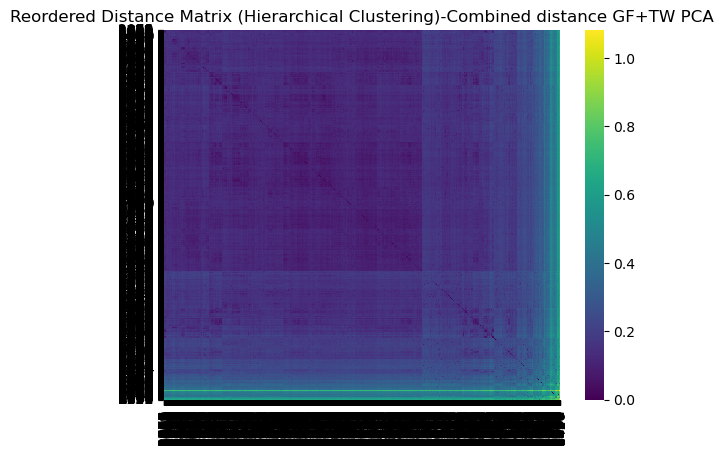

In [109]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=tw_pca_euclidean_combined_distances_dict[0.5], 
                                                            label_matrix='Combined distance GF+TW PCA')

##### 2D UMAP embeddings (TW PCA)

As with the time window euclidean distances, the 2D UMAP embeddings are obtained for visualization.

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_pca_2d_10neighbors.pkl

Plot for n_neighbors = 10


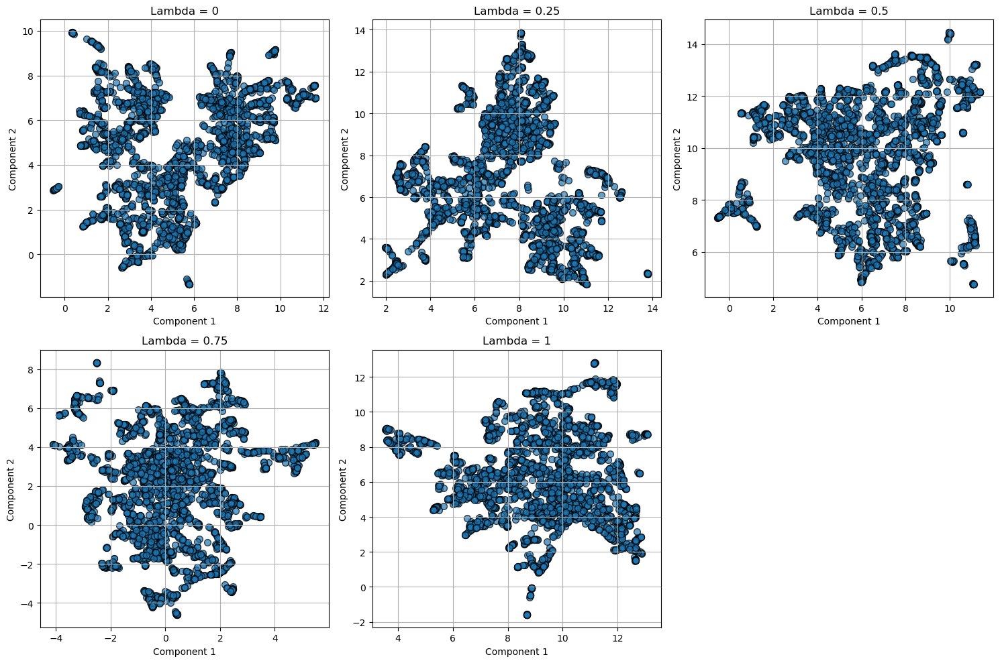

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_pca_2d_30neighbors.pkl

Plot for n_neighbors = 30


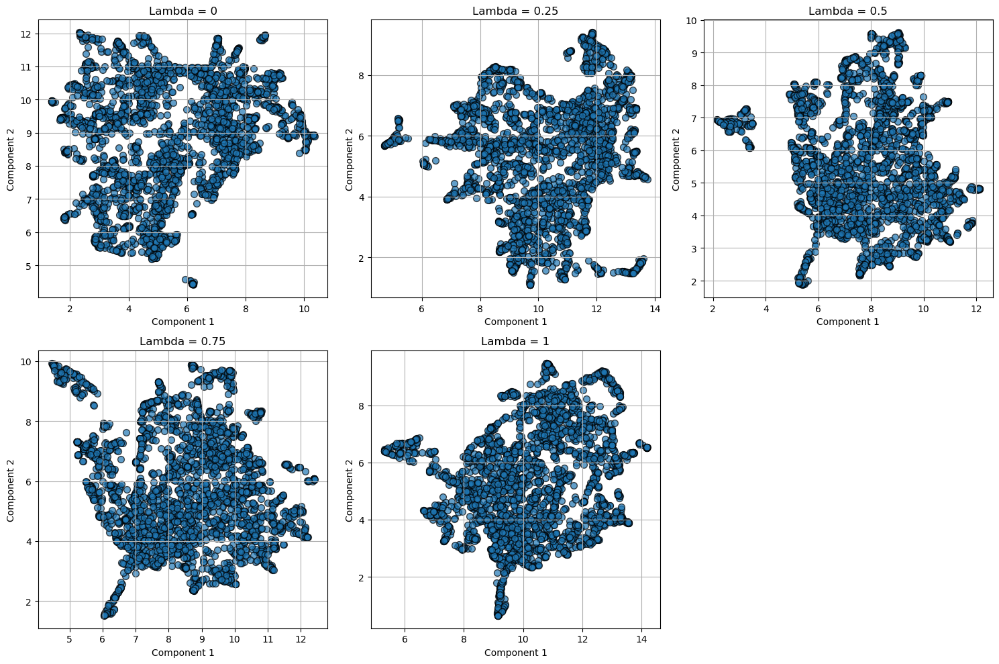

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_pca_2d_90neighbors.pkl

Plot for n_neighbors = 90


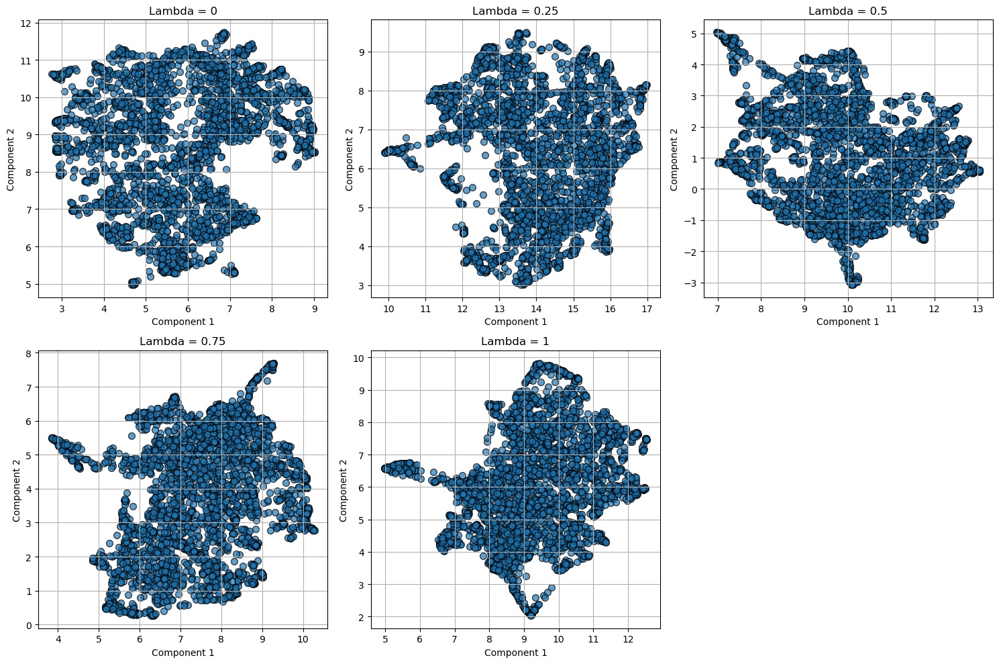

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_pca_2d_272neighbors.pkl

Plot for n_neighbors = 272


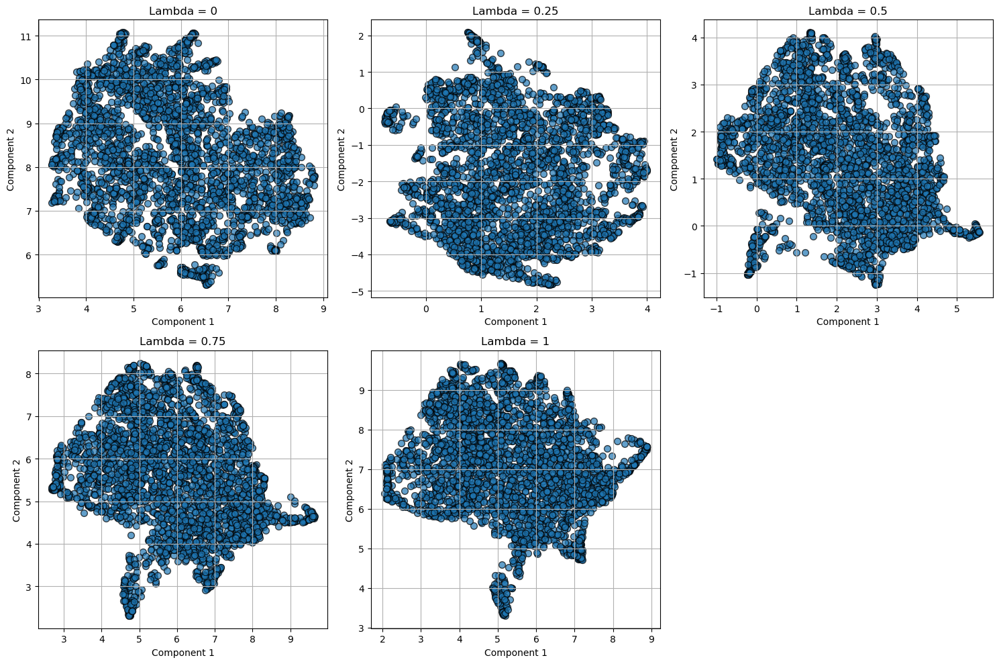

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_pca_2d_819neighbors.pkl

Plot for n_neighbors = 819


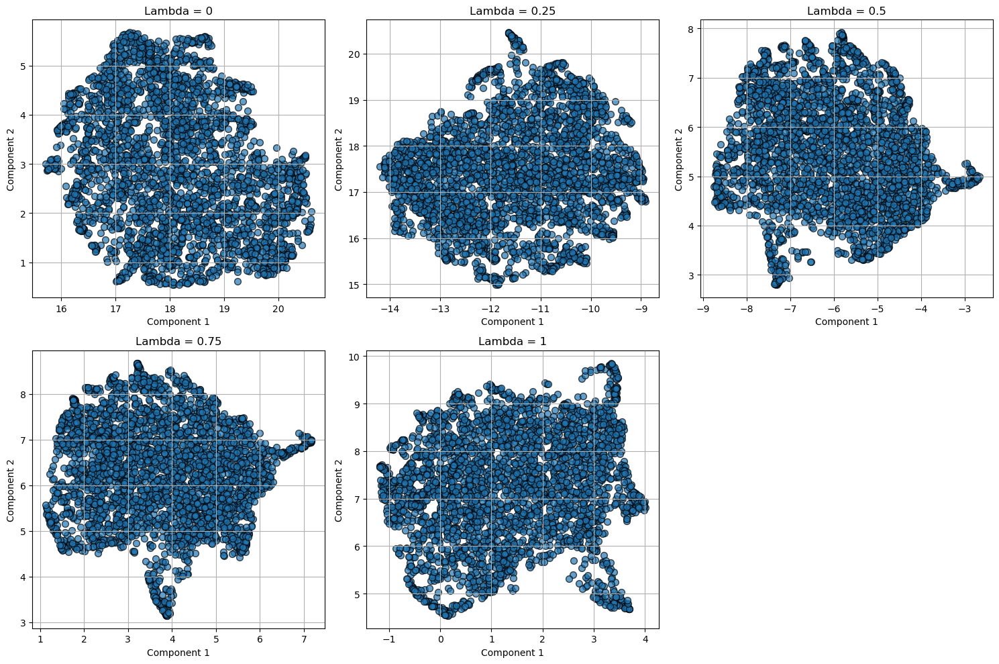

In [110]:
# Suppress warnings only within this cell
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    
    distances_calculations.check_multi_n_neighbors_umap(n_neighbors_list=n_neighbors_list,
                                                        combined_distances_dict=tw_pca_euclidean_combined_distances_dict,
                                                        path_rw=path_distances_embeddings,
                                                        distance_type='tw_pca',
                                                        read_write='write')

The value of `n_neighbors` remains the same as the one used above for consistency.

In [111]:
umaps_tw_pca_2d_final_filename = os.path.join(path_distances_embeddings,f'umaps_tw_pca_2d_{n_neighbors_umap}neighbors.pkl')

In [112]:
# Checking that the file loads correctly
with open(umaps_tw_pca_2d_final_filename, 'rb') as f:
    umaps_tw_pca_2d_final = pickle.load(f)
    print(f'Loaded UMAP distance embeddings from {umaps_tw_pca_2d_final_filename}')

Loaded UMAP distance embeddings from ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_pca_2d_30neighbors.pkl


##### Higher-Dimensional UMAP Embeddings (TW PCA)

Also, `n_components_umap_clustering`, the value of the higher umap dimensionality (used for clustering) is mantained for consistency.

In [115]:
umaps_tw_pca_higher_d_final_filename = os.path.join(path_distances_embeddings,f'umaps_tw_pca_{n_components_umap_clustering}d_{n_neighbors_umap}neighbors.pkl')

In [116]:
umaps_tw_pca_higher_d_final = distances_calculations.compute_umap_embeddings(distances_dict=tw_pca_euclidean_combined_distances_dict,
                                                                          umap_components=n_components_umap_clustering,
                                                                          umap_params={'min_dist':0, 
                                                                                       'n_neighbors':n_neighbors_umap},
                                                                          save_path=umaps_tw_pca_higher_d_final_filename)

c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.25


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.5


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.75


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_pca_5d_30neighbors.pkl


In [117]:
# Check that the file loads correctly
with open(umaps_tw_pca_higher_d_final_filename, 'rb') as f:
        umaps_tw_pca_higher_d_final = pickle.load(f)
        print(f'Loaded UMAP embeddings from {umaps_tw_pca_higher_d_final_filename}')

Loaded UMAP embeddings from ..\..\Datasets\Processed\distances_embeddings\both\umaps_tw_pca_5d_30neighbors.pkl


## Combined distances (DTW and GF)

The same followed before is implemented here, but replacing the TW euclidean distance with the DTW of the sequence of events.

### Combining the distances

In [118]:
dtw_combined_distances_dict = {lambda_val: 
                               distances_calculations.compute_combined_distance(distances_1=general_euclidean_distances_normalized,
                                                                                distances_2=dtw_distances_normalized,
                                                                                lambda_value=lambda_val
                                                                                )
                                for lambda_val in lambda_values
                              }

### Distance examination

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code\distances_calculations.py:483: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


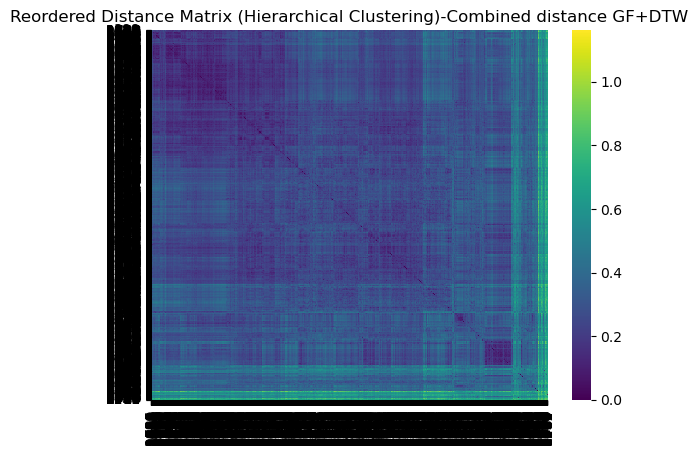

In [119]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=dtw_combined_distances_dict[0.5], 
                                                            label_matrix='Combined distance GF+DTW')

##### Checking if distance is metric

In [120]:
#is_distance_metric(dtw_combined_distances_dict)

##### 2D UMAP embeddings (DTW)

As with the time window euclidean distances, the 2D UMAP embeddings are obtained for visualization.

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_dtw_2d_10neighbors.pkl

Plot for n_neighbors = 10


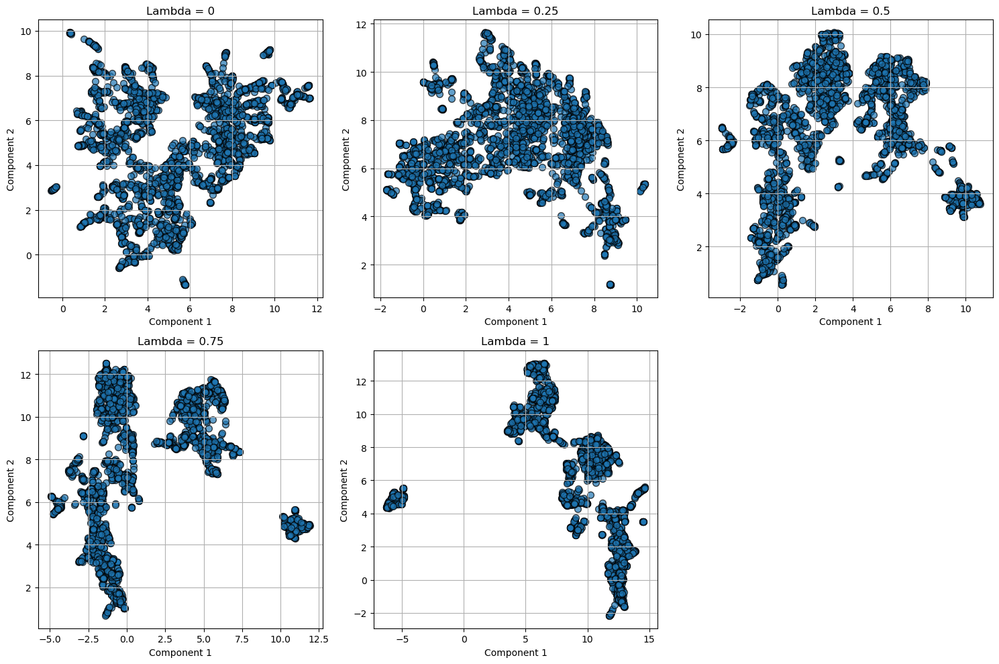

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_dtw_2d_30neighbors.pkl

Plot for n_neighbors = 30


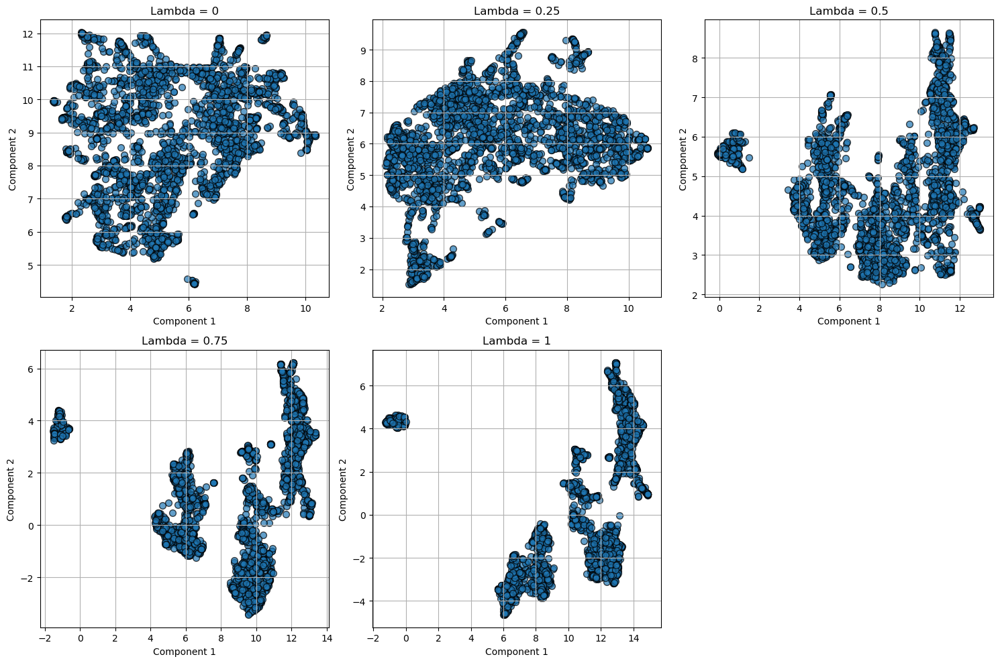

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_dtw_2d_90neighbors.pkl

Plot for n_neighbors = 90


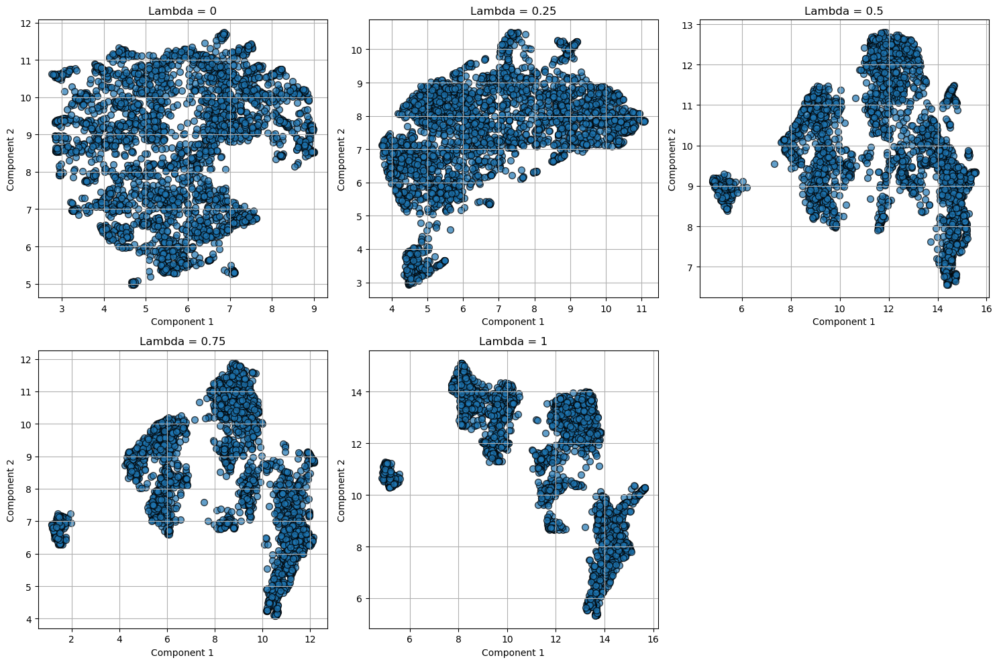

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_dtw_2d_272neighbors.pkl

Plot for n_neighbors = 272


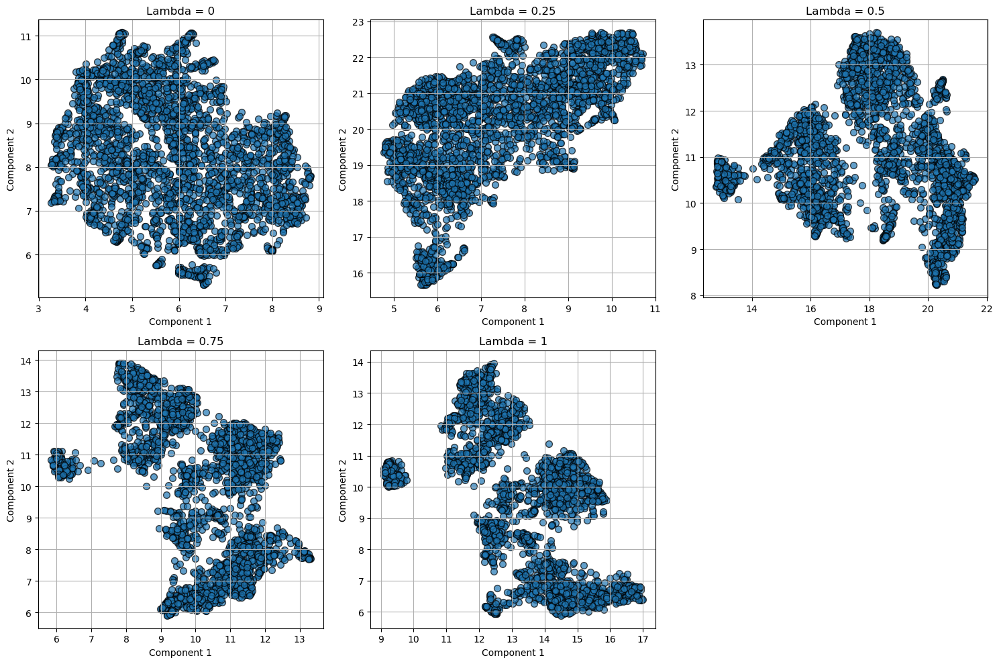

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_dtw_2d_819neighbors.pkl

Plot for n_neighbors = 819


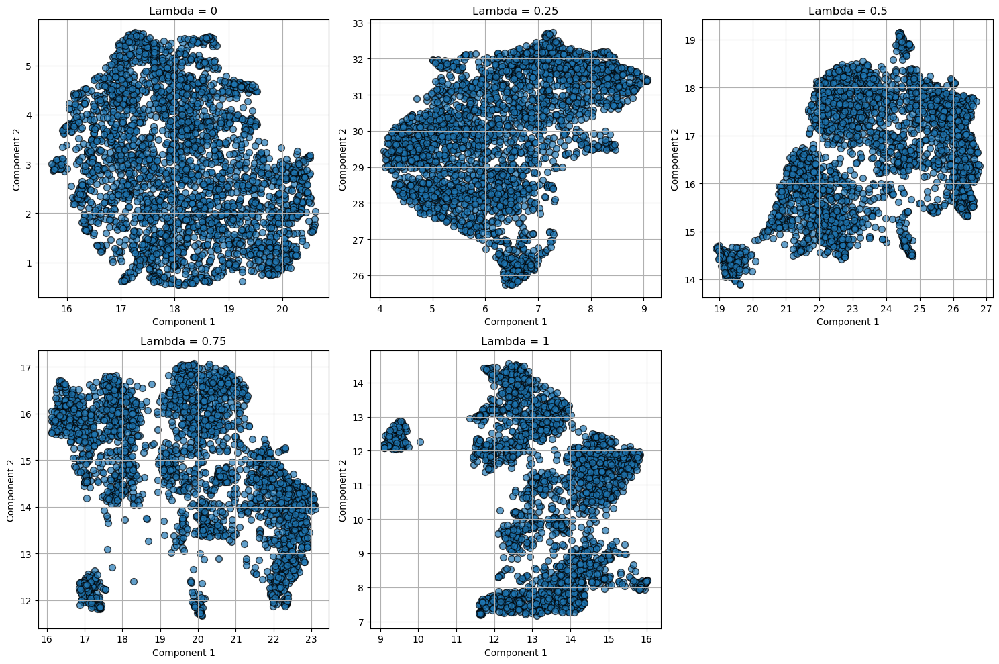

In [121]:
# Suppress warnings only within this cell
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    
    distances_calculations.check_multi_n_neighbors_umap(n_neighbors_list=n_neighbors_list,
                                                        combined_distances_dict=dtw_combined_distances_dict,
                                                        path_rw=path_distances_embeddings,
                                                        distance_type='dtw',
                                                        read_write='write')

The value of `n_neighbors` remains the same as the one used above for consistency.

In [122]:
umaps_dtw_2d_final_filename = os.path.join(path_distances_embeddings,f'umaps_dtw_2d_{n_neighbors_umap}neighbors.pkl')

In [123]:
with open(umaps_dtw_2d_final_filename, 'rb') as f:
    umaps_dtw_2d_final = pickle.load(f)
    print(f'Loaded UMAP distance embeddings from {umaps_dtw_2d_final_filename}')

Loaded UMAP distance embeddings from ..\..\Datasets\Processed\distances_embeddings\both\umaps_dtw_2d_30neighbors.pkl


##### Higher-Dimensional UMAP Embeddings (DTW)

In [125]:
distances_calculations.print_explained_variance_svd(distance_matrix=dtw_combined_distances_dict[0.5], 
                                                    n_components=5)

Explained variance with 5 components: 0.9456546527617934


Also, `n_components_umap_clustering`, the value of the higher umap dimensionality (used for clustering) is mantained for consistency.

In [126]:
umaps_dtw_higher_d_final_filename = os.path.join(path_distances_embeddings,f'umaps_dtw_{n_components_umap_clustering}d_{n_neighbors_umap}neighbors.pkl')

In [127]:
umaps_dtw_higher_d_final = distances_calculations.compute_umap_embeddings(distances_dict=dtw_combined_distances_dict,
                                                                          umap_components=n_components_umap_clustering,
                                                                          umap_params={'min_dist':0, 
                                                                                       'n_neighbors':n_neighbors_umap},
                                                                          save_path=umaps_dtw_higher_d_final_filename)

c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.25


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.5


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.75


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_dtw_5d_30neighbors.pkl


In [128]:
# Check that the file loads correctly
with open(umaps_dtw_higher_d_final_filename, 'rb') as f:
        umaps_dtw_higher_d_final = pickle.load(f)
        print(f'Loaded UMAP embeddings from {umaps_dtw_higher_d_final_filename}')

Loaded UMAP embeddings from ..\..\Datasets\Processed\distances_embeddings\both\umaps_dtw_5d_30neighbors.pkl


## Combined distances (LCSS and GF)

The same followed before is implemented here, but replacing the TW euclidean distance with the LCSS of the sequence of events.

### Combining the distances

In [129]:
lcss_combined_distances_dict = {lambda_val: 
                                distances_calculations.compute_combined_distance(distances_1=general_euclidean_distances_normalized,
                                                                                 distances_2=lcss_distances_normalized,
                                                                                 lambda_value=lambda_val
                                                                                 )
                                for lambda_val in lambda_values
                                }

In [130]:
lcss_combined_distances_dict[0.25]

array([[0.        , 0.26169558, 0.23079079, ..., 0.24244909, 0.19077441,
        0.33823986],
       [0.26169558, 0.        , 0.22690451, ..., 0.28615898, 0.24350379,
        0.24728577],
       [0.23079079, 0.22690451, 0.        , ..., 0.33630917, 0.22555552,
        0.1839647 ],
       ...,
       [0.24244909, 0.28615898, 0.33630917, ..., 0.        , 0.1854259 ,
        0.34220289],
       [0.19077441, 0.24350379, 0.22555552, ..., 0.1854259 , 0.        ,
        0.28412129],
       [0.33823986, 0.24728577, 0.1839647 , ..., 0.34220289, 0.28412129,
        0.        ]])

### Distance examination

C:\Camilo\Estudio\Padova\Master thesis\master-thesis-code\distances_calculations.py:483: ClusterWarning: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage_matrix = linkage(distance_matrix, method=method)


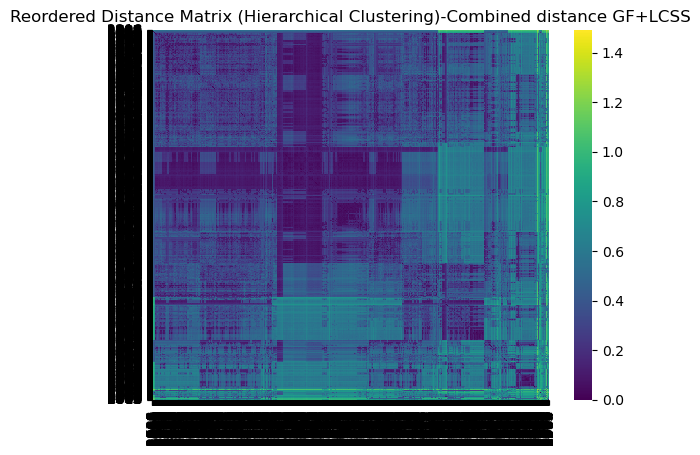

In [131]:
distances_calculations.plot_hierarchical_clustering_heatmap(distance_matrix=lcss_combined_distances_dict[0.5], label_matrix='Combined distance GF+LCSS')

##### Checking if distance is metric

In [132]:
#is_distance_metric(lcss_combined_distances_dict)

##### 2D UMAP embeddings (LCSS)

As with the time window euclidean distances, the 2D UMAP embeddings are obtained for visualization.

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_lcss_2d_10neighbors.pkl

Plot for n_neighbors = 10


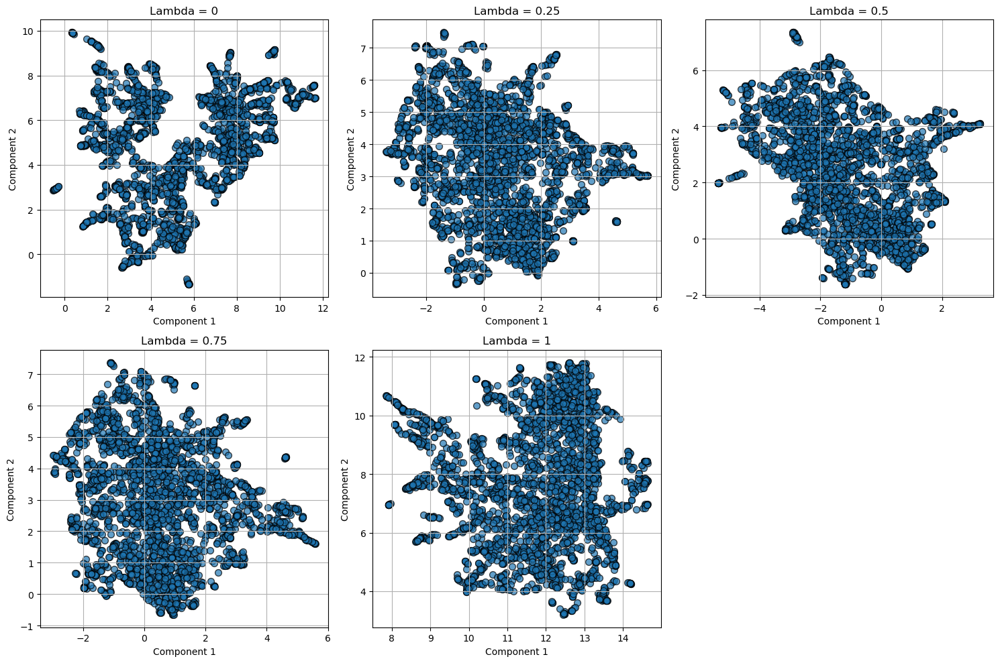

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_lcss_2d_30neighbors.pkl

Plot for n_neighbors = 30


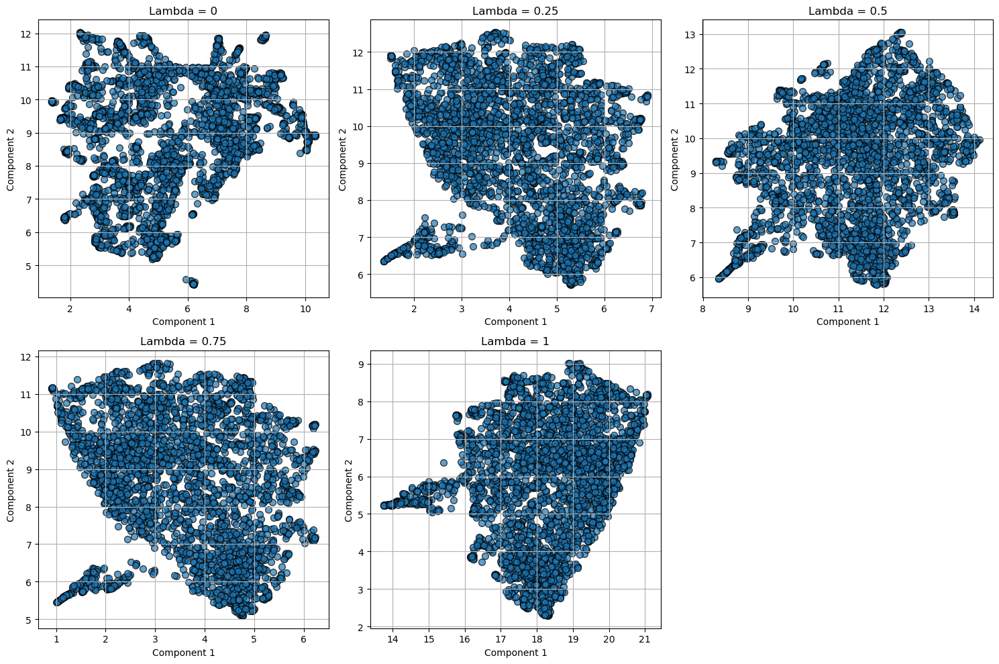

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_lcss_2d_90neighbors.pkl

Plot for n_neighbors = 90


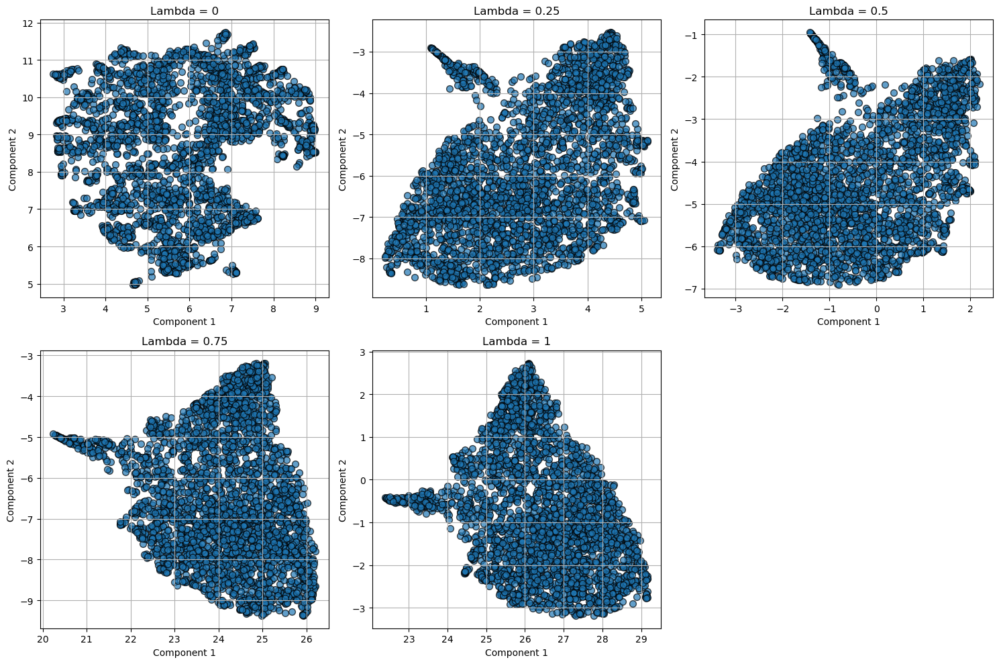

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_lcss_2d_272neighbors.pkl

Plot for n_neighbors = 272


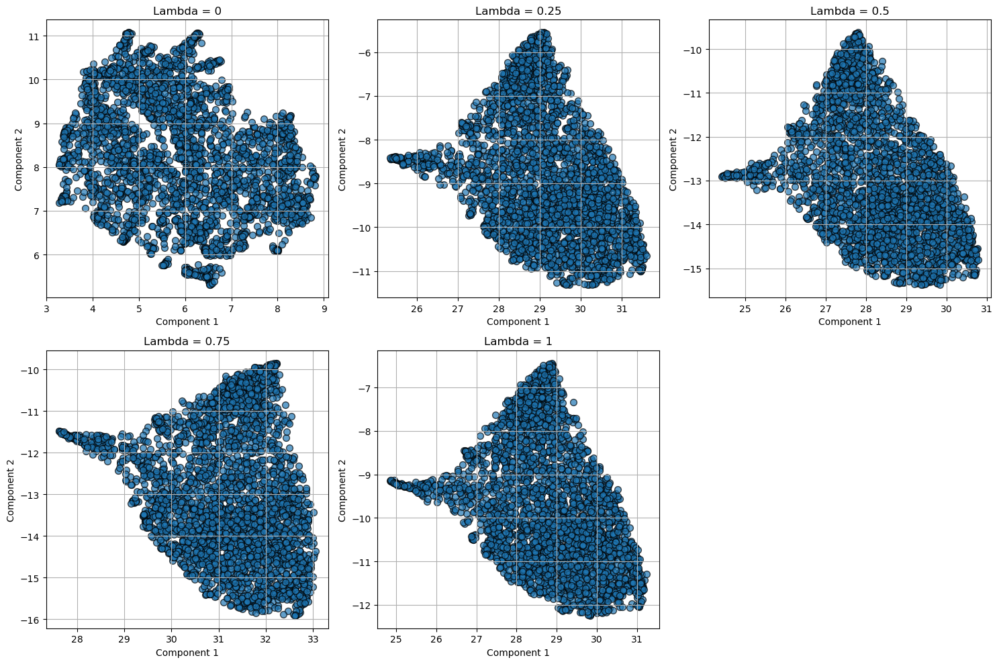

Computed the embeddings for lambda = 0
Computed the embeddings for lambda = 0.25
Computed the embeddings for lambda = 0.5
Computed the embeddings for lambda = 0.75
Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_lcss_2d_819neighbors.pkl

Plot for n_neighbors = 819


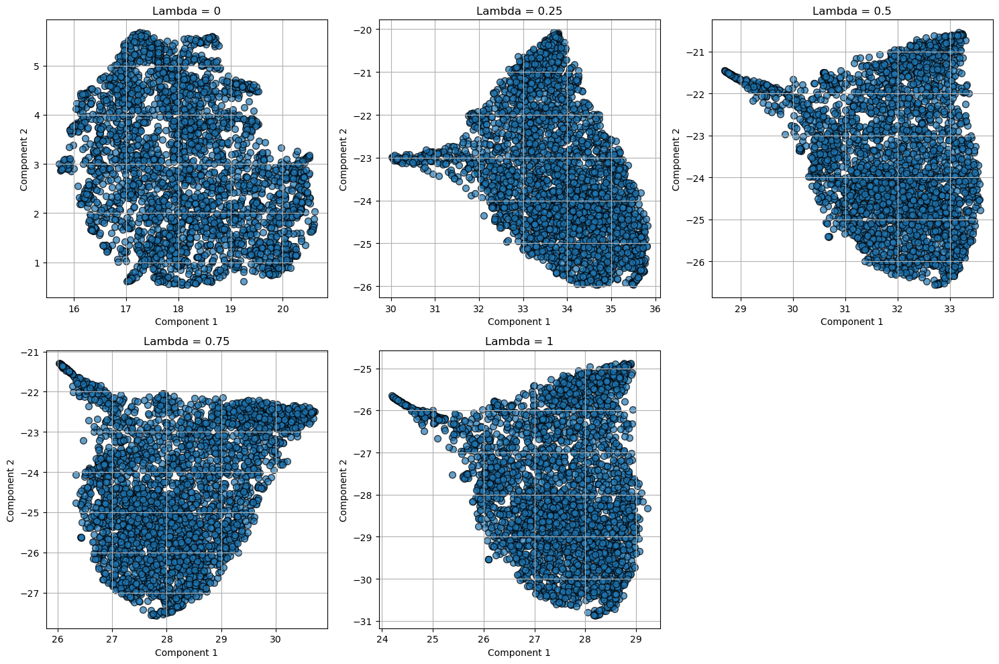

In [133]:
# Suppress warnings only within this cell
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    
    distances_calculations.check_multi_n_neighbors_umap(n_neighbors_list=n_neighbors_list,
                                                        combined_distances_dict=lcss_combined_distances_dict,
                                                        path_rw=path_distances_embeddings,
                                                        distance_type='lcss',
                                                        read_write='write')

The value of `n_neighbors` remains the same as the one used above for consistency.

In [134]:
umaps_lcss_2d_final_filename = os.path.join(path_distances_embeddings,f'umaps_lcss_2d_{n_neighbors_umap}neighbors.pkl')

In [135]:
# Checking that the file loads correctly
with open(umaps_lcss_2d_final_filename, 'rb') as f:
    umaps_lcss_2d_final = pickle.load(f)
    print(f'Loaded UMAP distance embeddings from {umaps_lcss_2d_final_filename}')

Loaded UMAP distance embeddings from ..\..\Datasets\Processed\distances_embeddings\both\umaps_lcss_2d_30neighbors.pkl


##### Higher-Dimensional UMAP Embeddings (LCSS)

Also, `n_components_umap_clustering`, the value of the higher umap dimensionality (used for clustering) is mantained for consistency.

In [138]:
umaps_lcss_higher_d_final_filename = os.path.join(path_distances_embeddings,f'umaps_lcss_{n_components_umap_clustering}d_{n_neighbors_umap}neighbors.pkl')

In [139]:
umaps_lcss_higher_d_final = distances_calculations.compute_umap_embeddings(distances_dict=lcss_combined_distances_dict,
                                                                           umap_components=n_components_umap_clustering,
                                                                           umap_params={'min_dist':0, 'n_neighbors':n_neighbors_umap},
                                                                           save_path=umaps_lcss_higher_d_final_filename)

c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.25


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.5


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 0.75


c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
c:\Users\camal\anaconda3\envs\skmob_updated_h3\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Computed the embeddings for lambda = 1
Saved UMAP embeddings to ..\..\Datasets\Processed\distances_embeddings\both\umaps_lcss_5d_30neighbors.pkl


In [140]:
# Check that the file loads correctly
with open(umaps_lcss_higher_d_final_filename, 'rb') as f:
        umaps_lcss_higher_d_final = pickle.load(f)
        print(f'Loaded UMAP embeddings from {umaps_lcss_higher_d_final_filename}')

Loaded UMAP embeddings from ..\..\Datasets\Processed\distances_embeddings\both\umaps_lcss_5d_30neighbors.pkl


## Writing the final distances_embeddings_settings dictionary

In [141]:
distances_embeddings_settings

{'night_interest': 'both',
 'include_trajs_no_events': False,
 'n_trajectories_dist_notebook': 3275,
 'n_neighbors_umap': 30,
 'n_components_umap_clustering': 5}

In [142]:
# Writing to a file with pretty formatting
distances_embeddings_settings_filename = os.path.join(path_distances_embeddings,"distances_embeddings_settings.json")
with open(distances_embeddings_settings_filename, "w") as file:
    json.dump(distances_embeddings_settings, file, indent='')